# Install MMSegmentation

In [ ]:
!nvidia-smi # Tesla P100이 출력되지 않으면 "런타임 초기화"

Tue Jun  7 07:24:11 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   37C    P0    27W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

1.11.0+cu113 True


In [ ]:
# Install MMCV
!pip install mmcv-full -f https://download.openmmlab.com/mmcv/dist/cu111/torch1.10.0/index.html

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.openmmlab.com/mmcv/dist/cu111/torch1.10.0/index.html
     |████████████████████████████████| 46.4 MB 266 kB/s 
     |████████████████████████████████| 190 kB 7.0 MB/s 


In [ ]:
!rm -rf mmsegmentation
!git clone https://github.com/museonghwang/mmsegmentation.git
#!git clone https://github.com/open-mmlab/mmsegmentation.git 
%cd mmsegmentation
!pip install -e .

Cloning into 'mmsegmentation'...
remote: Enumerating objects: 7003, done.
remote: Total 7003 (delta 0), reused 0 (delta 0), pack-reused 7003
Receiving objects: 100% (7003/7003), 13.26 MiB | 20.76 MiB/s, done.
Resolving deltas: 100% (5176/5176), done.
/content/mmsegmentation
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Obtaining file:///content/mmsegmentation
     |████████████████████████████████| 577 kB 8.0 MB/s 
     |████████████████████████████████| 631 kB 57.7 MB/s 
  Created wheel for imgaug: filename=imgaug-0.2.6-py3-none-any.whl size=654017 sha256=831eb844535b610f70c63e0db6b3cf4ff6456316f40b68229aee2f2fc03f1f28
  Stored in directory: /root/.cache/pip/wheels/89/72/98/3ebfdba1069a9a8eaaa7ae7265cfd67d63ef0197aaee2e5f9c
Successfully built imgaug
  Attempting uninstall: imgaug
    Found existing installation: imgaug 0.2.9
    Uninstalling imgaug-0.2.9:
      Successfully uninstalled imgaug-0.2.9
  Running setup.py develop for mms

In [ ]:
# 런타임 -> 런타임 "다시 시작" 후 아래 수행. 
# Check Pytorch installation
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

# Check MMSegmentation installation
import mmseg
print(mmseg.__version__)

1.11.0+cu113 True
0.24.1


# Run Inference with MMSeg trained weight

In [ ]:
%cd mmsegmentation
!mkdir checkpoints
!wget https://download.openmmlab.com/mmsegmentation/v0.5/segformer/segformer_mit-b5_8x1_1024x1024_160k_cityscapes/segformer_mit-b5_8x1_1024x1024_160k_cityscapes_20211206_072934-87a052ec.pth -P checkpoints

/content/mmsegmentation
--2022-06-03 01:36:21--  https://download.openmmlab.com/mmsegmentation/v0.5/segformer/segformer_mit-b5_8x1_1024x1024_160k_cityscapes/segformer_mit-b5_8x1_1024x1024_160k_cityscapes_20211206_072934-87a052ec.pth
Resolving download.openmmlab.com (download.openmmlab.com)... 47.88.36.72
Connecting to download.openmmlab.com (download.openmmlab.com)|47.88.36.72|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 328290585 (313M) [application/octet-stream]
Saving to: ‘checkpoints/segformer_mit-b5_8x1_1024x1024_160k_cityscapes_20211206_072934-87a052ec.pth’

segformer_mit-b5_8x 100%[===================>] 313.08M  13.5MB/s    in 24s     

2022-06-03 01:36:46 (13.0 MB/s) - ‘checkpoints/segformer_mit-b5_8x1_1024x1024_160k_cityscapes_20211206_072934-87a052ec.pth’ saved [328290585/328290585]



In [ ]:
from mmseg.apis import inference_segmentor, init_segmentor, show_result_pyplot
from mmseg.core.evaluation import get_palette

In [ ]:
config_file = '/content/mmsegmentation/configs/segformer/segformer_mit-b5_8x1_1024x1024_160k_cityscapes.py'
checkpoint_file = '/content/mmsegmentation/checkpoints/segformer_mit-b5_8x1_1024x1024_160k_cityscapes_20211206_072934-87a052ec.pth'

In [ ]:
# build the model from a config file and a checkpoint file
model = init_segmentor(config_file, checkpoint_file, device='cuda:0')

/content/mmsegmentation/mmseg/models/losses/cross_entropy_loss.py:236: UserWarning: Default ``avg_non_ignore`` is False, if you would like to ignore the certain label and average loss over non-ignore labels, which is the same with PyTorch official cross_entropy, set ``avg_non_ignore=True``.
  'Default ``avg_non_ignore`` is False, if you would like to '


load checkpoint from local path: /content/mmsegmentation/checkpoints/segformer_mit-b5_8x1_1024x1024_160k_cityscapes_20211206_072934-87a052ec.pth


In [ ]:
# test a single image
img = '/content/mmsegmentation/demo/demo.png'
result = inference_segmentor(model, img)

/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


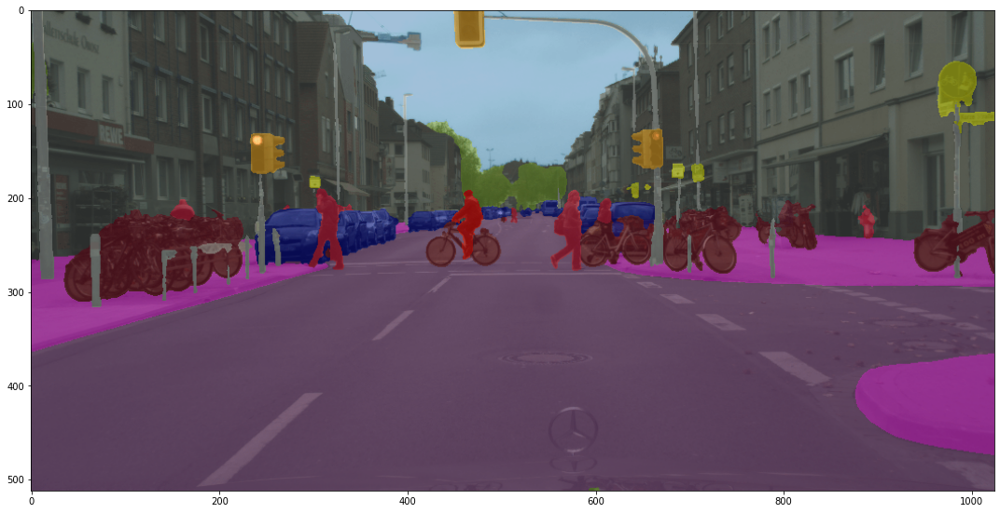

In [ ]:
# show the results
show_result_pyplot(model, img, result, get_palette('cityscapes'))

## Train a semantic segmentation model on a new dataset

To train on a customized dataset, the following steps are necessary. 
1. Add a new dataset class. 
2. Create a config file accordingly. 
3. Perform training and evaluation. 

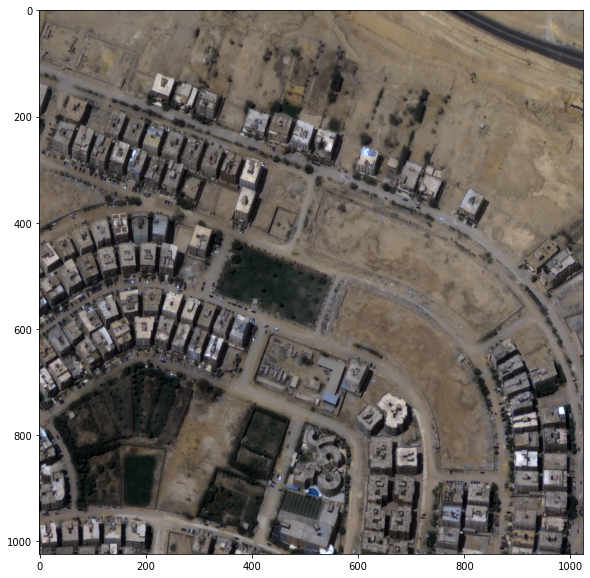

In [ ]:
# Let's take a look at the dataset
import mmcv
import matplotlib.pyplot as plt

img = mmcv.imread('/content/drive/Shareddrives/msmg/level1/dataset/train/road/image/BLD00057_PS3_K3A_NIA0276.png')
plt.figure(figsize=(10, 10))
plt.imshow(mmcv.bgr2rgb(img))
plt.show()

In [ ]:
import os.path as osp
import numpy as np
from PIL import Image
import cv2

# convert dataset annotation to semantic segmentation map
data_root = '/content/drive/Shareddrives/msmg/level1/dataset/train/road'
img_dir = 'image'
ann_dir = 'annotation'

# define class and plaette for better visualization
classes = ('background', 'road')
palette = [[0, 0, 0], [255, 0, 255]]

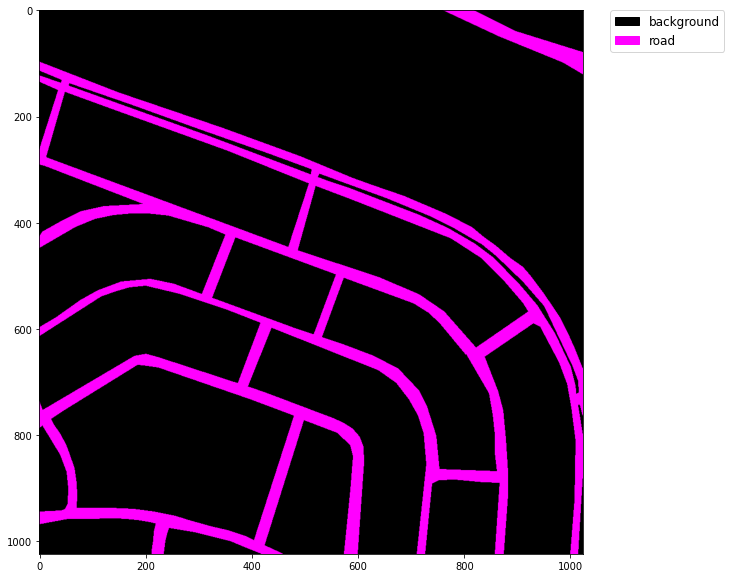

In [ ]:
# Let's take a look at the segmentation map we got
import matplotlib.patches as mpatches

img = Image.open('/content/drive/Shareddrives/msmg/level1/dataset/train/road/annotation/BLD00057_PS3_K3A_NIA0276.png')
plt.figure(figsize=(10, 10))
im = plt.imshow(np.array(img.convert('RGB')))

# create a patch (proxy artist) for every color 
patches = [mpatches.Patch(color=np.array(palette[i])/255., label=classes[i]) for i in range(2)]

# put those patched as legend-handles into the legend
plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize='large')

plt.show()

# Create a config file
In the next step, we need to modify the config for the training. To accelerate the process, we finetune the model from trained weights.

In [ ]:
config_file = '/content/mmsegmentation/configs/segformer/segformer_mit-b5_8x1_1024x1024_160k_cityscapes.py'
checkpoint_file = '/content/mmsegmentation/checkpoints/segformer_mit-b5_8x1_1024x1024_160k_cityscapes_20211206_072934-87a052ec.pth'
save_pth_path = '/content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint'

In [ ]:
# convert dataset annotation to semantic segmentation map
data_root = '/content/drive/Shareddrives/msmg/level1/dataset/train/road'
img_dir = 'image'
ann_dir = 'annotation'

# define class and plaette for better visualization
classes = ('background', 'road')
palette = [[0, 0, 0], [255, 0, 255]]

In [ ]:
from mmseg.datasets.builder import DATASETS
from mmseg.datasets.custom import CustomDataset

@DATASETS.register_module(force=True)
class RoadSemanticSegmentation(CustomDataset):
    CLASSES = classes
    PALETTE = palette
    def __init__(self, split, **kwargs):
        super().__init__(img_suffix='.png', seg_map_suffix='.png', split=split, **kwargs)
        assert osp.exists(self.img_dir) and self.split is not None

In [ ]:
from mmcv import Config

cfg = Config.fromfile(config_file)

In [ ]:
from mmseg.apis import set_random_seed

# add CLASSES and PALETTE to checkpoint
cfg.checkpoint_config.meta = dict(
    CLASSES=classes,
    PALETTE=palette)

# Since we use only one GPU, BN is used instead of SyncBN
cfg.norm_cfg = dict(type='BN', requires_grad=True)
#cfg.model.backbone.norm_cfg = cfg.norm_cfg
cfg.model.decode_head.norm_cfg = cfg.norm_cfg

# modify num classes of the model in decode/auxiliary head
cfg.model.decode_head.num_classes = 2

# modify loss function crossentropy
#cfg.model.decode_head.loss_decode = dict(type='CrossEntropyLoss', class_weight=[1, 2], use_sigmoid=False, loss_weight=1.0)

#cfg.model.test_cfg.mode = 'whole'
#del cfg['model']['test_cfg']['crop_size']
#del cfg['model']['test_cfg']['stride']

# Modify dataset type and path
cfg.dataset_type = 'RoadSemanticSegmentation'
cfg.data_root = data_root

cfg.data.samples_per_gpu = 6
cfg.data.workers_per_gpu = 6

# Albumentations transforms settings
albu_train_transforms = [
    dict(
    type='OneOf',
    transforms=[
        dict(type='RandomRotate90', p=1.0)
    ], p=0.5),

    dict(
    type='OneOf',
    transforms=[
        dict(type='RandomBrightnessContrast',brightness_limit=0.1, contrast_limit=0.15, p=1.0),
        dict(type='CLAHE', clip_limit=4.0, tile_grid_size=(8, 8), always_apply=False, p=1.0),
        dict(type='HueSaturationValue', hue_shift_limit=15, sat_shift_limit=25, val_shift_limit=10, p=1.0),
    ], p=0.5)
]

# pipline
cfg.img_norm_cfg = dict(
    mean=[123.675, 116.28, 103.53], std=[58.395, 57.12, 57.375], to_rgb=True)
cfg.crop_size = (512, 512)
cfg.train_pipeline = [
    dict(type='LoadImageFromFile'),
    dict(type='LoadAnnotations'),
    dict(type='Resize', img_scale=(1024, 1024), ratio_range=(0.5, 1.5)),
    dict(type='RandomCrop', crop_size=cfg.crop_size, cat_max_ratio=0.75),
    dict(type='RandomFlip', flip_ratio=0.5),
    dict(
        type='Albu',
        transforms=albu_train_transforms,
        keymap=dict(img='image', gt_semantic_seg='mask'),
        update_pad_shape=True,
        ),
    dict(type='PhotoMetricDistortion'),
    dict(type='Normalize', **cfg.img_norm_cfg),
    dict(type='Pad', size=cfg.crop_size, pad_val=0, seg_pad_val=255),
    dict(type='DefaultFormatBundle'),
    dict(type='Collect', keys=['img', 'gt_semantic_seg']),
]

cfg.test_pipeline = [
    dict(type='LoadImageFromFile'),
    dict(
        type='MultiScaleFlipAug',
        img_scale=(1024, 1024),
        # img_ratios=[0.5, 0.75, 1.0, 1.25, 1.5, 1.75],
        flip=False,
        transforms=[
            dict(type='Resize', keep_ratio=True),
            dict(type='RandomFlip'),
            dict(type='Normalize', **cfg.img_norm_cfg),
            dict(type='ImageToTensor', keys=['img']),
            dict(type='Collect', keys=['img']),
        ])
]

cfg.data.train.type = cfg.dataset_type
cfg.data.train.data_root = '/content/drive/Shareddrives/msmg/level1/dataset/train/road/'
cfg.data.train.img_dir = 'image'
cfg.data.train.ann_dir = 'annotation'
cfg.data.train.pipeline = cfg.train_pipeline
cfg.data.train.split = 'split/train.txt'

cfg.data.val.type = cfg.dataset_type
cfg.data.val.data_root = '/content/drive/Shareddrives/msmg/level1/dataset/validation/road/'
cfg.data.val.img_dir = 'image'
cfg.data.val.ann_dir = 'annotation'
cfg.data.val.pipeline = cfg.test_pipeline
cfg.data.val.split = 'split/validation.txt'

cfg.data.test.type = cfg.dataset_type
cfg.data.test.data_root = '/content/drive/Shareddrives/msmg/level1/dataset/validation/road/'
cfg.data.test.img_dir = 'image'
cfg.data.test.ann_dir = 'annotation'
cfg.data.test.pipeline = cfg.test_pipeline
cfg.data.test.split = 'split/validation.txt'

# We can still use the pre-trained Mask RCNN model though we do not need to
# use the mask branch
cfg.load_from = checkpoint_file

# Set up working dir to save files and logs.
cfg.work_dir = save_pth_path

cfg.runner.max_iters = 10000
cfg.log_config.interval = 10
cfg.evaluation.interval = 100
cfg.evaluation.save_best = 'mIoU'
cfg.checkpoint_config.interval = 2000

# Set seed to facitate reproducing the result
cfg.seed = 0
set_random_seed(0, deterministic=False)
cfg.gpu_ids = range(1)

# We can also use tensorboard to log the training process
cfg.log_config.hooks = [
    dict(type='TextLoggerHook'),
    dict(type='TensorboardLoggerHook')]

# Let's have a look at the final config used for training
print(f'Config:\n{cfg.pretty_text}')

Config:
norm_cfg = dict(type='BN', requires_grad=True)
model = dict(
    type='EncoderDecoder',
    pretrained=None,
    backbone=dict(
        type='MixVisionTransformer',
        in_channels=3,
        embed_dims=64,
        num_stages=4,
        num_layers=[3, 6, 40, 3],
        num_heads=[1, 2, 5, 8],
        patch_sizes=[7, 3, 3, 3],
        sr_ratios=[8, 4, 2, 1],
        out_indices=(0, 1, 2, 3),
        mlp_ratio=4,
        qkv_bias=True,
        drop_rate=0.0,
        attn_drop_rate=0.0,
        drop_path_rate=0.1,
        init_cfg=dict(type='Pretrained', checkpoint='pretrain/mit_b5.pth')),
    decode_head=dict(
        type='SegformerHead',
        in_channels=[64, 128, 320, 512],
        in_index=[0, 1, 2, 3],
        channels=256,
        dropout_ratio=0.1,
        num_classes=2,
        norm_cfg=dict(type='BN', requires_grad=True),
        align_corners=False,
        loss_decode=dict(
            type='CrossEntropyLoss', use_sigmoid=False, loss_weight=1.0)),
    train_cfg

# Train and Evaluation

In [ ]:
from mmseg.datasets import build_dataset
from mmseg.models import build_segmentor
from mmseg.apis import train_segmentor

# Build the dataset
datasets = [build_dataset(cfg.data.train)]

2022-06-03 01:37:31,427 - mmseg - INFO - Loaded 1144 images


In [ ]:
# Build the detector
model = build_segmentor(
    cfg.model, train_cfg=cfg.get('train_cfg'), test_cfg=cfg.get('test_cfg'))

# Add an attribute for visualization convenience
model.CLASSES = datasets[0].CLASSES

/content/mmsegmentation/mmseg/models/losses/cross_entropy_loss.py:236: UserWarning: Default ``avg_non_ignore`` is False, if you would like to ignore the certain label and average loss over non-ignore labels, which is the same with PyTorch official cross_entropy, set ``avg_non_ignore=True``.
  'Default ``avg_non_ignore`` is False, if you would like to '


In [ ]:
# Create work_dir
mmcv.mkdir_or_exist(osp.abspath(cfg.work_dir))
train_segmentor(model, datasets, cfg, distributed=False, validate=True, meta=dict())

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:490: UserWarning: This DataLoader will create 6 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
2022-06-03 01:37:41,260 - mmseg - INFO - Loaded 127 images
2022-06-03 01:37:41,264 - mmseg - INFO - load checkpoint from local path: /content/mmsegmentation/checkpoints/segformer_mit-b5_8x1_1024x1024_160k_cityscapes_20211206_072934-87a052ec.pth
2022-06-03 01:37:41,866 - mmseg - WARNING - The model and loaded state dict do not match exactly

size mismatch for decode_head.conv_seg.weight: copying a param with shape torch.Size([19, 256, 1, 1]) from checkpoint, the shape in current model is torch.Size([2, 256, 1, 1]).
size mismatch for decode

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 1.3 task/s, elapsed: 95s, ETA:     0s

2022-06-03 01:42:17,246 - mmseg - INFO - per class results:
2022-06-03 01:42:17,248 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 89.06 | 99.72 |
|    road    |  1.2  |  1.23 |
+------------+-------+-------+
2022-06-03 01:42:17,252 - mmseg - INFO - Summary:
2022-06-03 01:42:17,256 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 89.07 | 45.13 | 50.47 |
+-------+-------+-------+
2022-06-03 01:42:25,387 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_100.pth.
2022-06-03 01:42:25,389 - mmseg - INFO - Best mIoU is 0.4513 at 100 iter.
2022-06-03 01:42:25,396 - mmseg - INFO - Iter(val) [127]	aAcc: 0.8907, mIoU: 0.4513, mAcc: 0.5047, IoU.background: 0.8906, IoU.road: 0.0120, Acc.background: 0.9972, Acc.road: 0.0123
2022-06-03 01:42:42,162 - mmseg - INFO - Iter [110/10000]	lr: 4.313e-06, eta: 7:26:20, time: 11.964, data_time: 10.297, memory: 13841, de

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 01:46:03,528 - mmseg - INFO - per class results:
2022-06-03 01:46:03,532 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 90.51 | 98.74 |
|    road    | 22.68 | 25.04 |
+------------+-------+-------+
2022-06-03 01:46:03,535 - mmseg - INFO - Summary:
2022-06-03 01:46:03,538 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 90.77 | 56.6 | 61.89 |
+-------+------+-------+
2022-06-03 01:46:03,548 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_100.pth was removed
2022-06-03 01:46:11,407 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_200.pth.
2022-06-03 01:46:11,412 - mmseg - INFO - Best mIoU is 0.5660 at 200 iter.
2022-06-03 01:46:11,416 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9077, mIoU: 0.5660, mAcc: 0.6189, IoU.background: 0.9051, Io

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 01:49:42,593 - mmseg - INFO - per class results:
2022-06-03 01:49:42,596 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  91.8 |  96.6 |
|    road    | 44.39 | 56.83 |
+------------+-------+-------+
2022-06-03 01:49:42,600 - mmseg - INFO - Summary:
2022-06-03 01:49:42,602 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 92.31 | 68.1 | 76.72 |
+-------+------+-------+
2022-06-03 01:49:42,615 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_200.pth was removed
2022-06-03 01:49:50,508 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_300.pth.
2022-06-03 01:49:50,510 - mmseg - INFO - Best mIoU is 0.6810 at 300 iter.
2022-06-03 01:49:50,516 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9231, mIoU: 0.6810, mAcc: 0.7672, IoU.background: 0.9180, Io

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 01:53:27,136 - mmseg - INFO - per class results:
2022-06-03 01:53:27,139 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  92.5 | 97.33 |
|    road    | 46.63 | 56.91 |
+------------+-------+-------+
2022-06-03 01:53:27,142 - mmseg - INFO - Summary:
2022-06-03 01:53:27,146 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.96 | 69.56 | 77.12 |
+-------+-------+-------+
2022-06-03 01:53:27,156 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_300.pth was removed
2022-06-03 01:53:34,875 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_400.pth.
2022-06-03 01:53:34,877 - mmseg - INFO - Best mIoU is 0.6956 at 400 iter.
2022-06-03 01:53:34,883 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9296, mIoU: 0.6956, mAcc: 0.7712, IoU.background: 0.925

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 01:57:05,978 - mmseg - INFO - per class results:
2022-06-03 01:57:05,980 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.68 | 96.61 |
|    road    | 50.83 | 65.07 |
+------------+-------+-------+
2022-06-03 01:57:05,982 - mmseg - INFO - Summary:
2022-06-03 01:57:05,986 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 93.2 | 71.75 | 80.84 |
+------+-------+-------+
2022-06-03 01:57:06,000 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_400.pth was removed
2022-06-03 01:57:14,867 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_500.pth.
2022-06-03 01:57:14,868 - mmseg - INFO - Best mIoU is 0.7175 at 500 iter.
2022-06-03 01:57:14,875 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9320, mIoU: 0.7175, mAcc: 0.8084, IoU.background: 0.9268, Io

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 02:00:51,243 - mmseg - INFO - per class results:
2022-06-03 02:00:51,246 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  92.7 | 96.38 |
|    road    | 51.77 | 67.24 |
+------------+-------+-------+
2022-06-03 02:00:51,250 - mmseg - INFO - Summary:
2022-06-03 02:00:51,253 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 93.23 | 72.23 | 81.81 |
+-------+-------+-------+
2022-06-03 02:00:51,267 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_500.pth was removed
2022-06-03 02:00:59,253 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_600.pth.
2022-06-03 02:00:59,255 - mmseg - INFO - Best mIoU is 0.7223 at 600 iter.
2022-06-03 02:00:59,264 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9323, mIoU: 0.7223, mAcc: 0.8181, IoU.background: 0.927

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 02:04:30,311 - mmseg - INFO - per class results:
2022-06-03 02:04:30,315 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.05 | 96.94 |
|    road    | 52.34 | 65.57 |
+------------+-------+-------+
2022-06-03 02:04:30,318 - mmseg - INFO - Summary:
2022-06-03 02:04:30,321 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 93.55 | 72.7 | 81.25 |
+-------+------+-------+
2022-06-03 02:04:30,335 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_600.pth was removed
2022-06-03 02:04:38,591 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_700.pth.
2022-06-03 02:04:38,593 - mmseg - INFO - Best mIoU is 0.7270 at 700 iter.
2022-06-03 02:04:38,603 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9355, mIoU: 0.7270, mAcc: 0.8125, IoU.background: 0.9305, Io

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 02:08:14,706 - mmseg - INFO - per class results:
2022-06-03 02:08:14,709 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.37 | 97.14 |
|    road    | 53.94 | 66.65 |
+------------+-------+-------+
2022-06-03 02:08:14,712 - mmseg - INFO - Summary:
2022-06-03 02:08:14,714 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 93.85 | 73.66 | 81.9 |
+-------+-------+------+
2022-06-03 02:08:14,728 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_700.pth was removed
2022-06-03 02:08:23,195 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_800.pth.
2022-06-03 02:08:23,196 - mmseg - INFO - Best mIoU is 0.7366 at 800 iter.
2022-06-03 02:08:23,202 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9385, mIoU: 0.7366, mAcc: 0.8190, IoU.background: 0.9337, Io

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 02:11:54,276 - mmseg - INFO - per class results:
2022-06-03 02:11:54,278 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.73 | 97.87 |
|    road    | 54.05 | 63.54 |
+------------+-------+-------+
2022-06-03 02:11:54,283 - mmseg - INFO - Summary:
2022-06-03 02:11:54,285 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.16 | 73.89 | 80.71 |
+-------+-------+-------+
2022-06-03 02:11:54,295 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_800.pth was removed
2022-06-03 02:12:02,467 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_900.pth.
2022-06-03 02:12:02,469 - mmseg - INFO - Best mIoU is 0.7389 at 900 iter.
2022-06-03 02:12:02,474 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9416, mIoU: 0.7389, mAcc: 0.8071, IoU.background: 0.937

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 02:15:38,510 - mmseg - INFO - per class results:
2022-06-03 02:15:38,516 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.56 | 97.29 |
|    road    | 54.84 | 67.08 |
+------------+-------+-------+
2022-06-03 02:15:38,517 - mmseg - INFO - Summary:
2022-06-03 02:15:38,522 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 94.03 | 74.2 | 82.19 |
+-------+------+-------+
2022-06-03 02:15:38,530 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_900.pth was removed
2022-06-03 02:15:46,619 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_1000.pth.
2022-06-03 02:15:46,621 - mmseg - INFO - Best mIoU is 0.7420 at 1000 iter.
2022-06-03 02:15:46,627 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9403, mIoU: 0.7420, mAcc: 0.8219, IoU.background: 0.9356, 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 02:19:17,799 - mmseg - INFO - per class results:
2022-06-03 02:19:17,800 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.06 | 96.74 |
|    road    | 53.05 | 67.33 |
+------------+-------+-------+
2022-06-03 02:19:17,803 - mmseg - INFO - Summary:
2022-06-03 02:19:17,806 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 93.56 | 73.05 | 82.03 |
+-------+-------+-------+
2022-06-03 02:19:17,809 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9356, mIoU: 0.7305, mAcc: 0.8203, IoU.background: 0.9306, IoU.road: 0.5305, Acc.background: 0.9674, Acc.road: 0.6733
2022-06-03 02:19:34,314 - mmseg - INFO - Iter [1110/10000]	lr: 3.944e-05, eta: 5:35:02, time: 6.260, data_time: 4.620, memory: 13842, decode.loss_ce: 0.1857, decode.acc_seg: 92.4926, loss: 0.1857
2022-06-03 02:19:50,800 - mmseg - INFO - Iter [1120/10000]	lr: 3.975e-05, eta: 5:33:51, time: 1.649, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 02:22:53,449 - mmseg - INFO - per class results:
2022-06-03 02:22:53,452 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.35 | 96.38 |
|    road    | 56.36 | 73.21 |
+------------+-------+-------+
2022-06-03 02:22:53,456 - mmseg - INFO - Summary:
2022-06-03 02:22:53,460 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 93.87 | 74.85 | 84.79 |
+-------+-------+-------+
2022-06-03 02:22:53,471 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_1000.pth was removed
2022-06-03 02:23:01,287 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_1200.pth.
2022-06-03 02:23:01,289 - mmseg - INFO - Best mIoU is 0.7485 at 1200 iter.
2022-06-03 02:23:01,291 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9387, mIoU: 0.7485, mAcc: 0.8479, IoU.background: 0.

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 02:26:32,517 - mmseg - INFO - per class results:
2022-06-03 02:26:32,519 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.79 | 97.87 |
|    road    | 54.51 | 64.11 |
+------------+-------+-------+
2022-06-03 02:26:32,523 - mmseg - INFO - Summary:
2022-06-03 02:26:32,525 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.22 | 74.15 | 80.99 |
+-------+-------+-------+
2022-06-03 02:26:32,529 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9422, mIoU: 0.7415, mAcc: 0.8099, IoU.background: 0.9379, IoU.road: 0.5451, Acc.background: 0.9787, Acc.road: 0.6411
2022-06-03 02:26:48,994 - mmseg - INFO - Iter [1310/10000]	lr: 4.551e-05, eta: 5:25:33, time: 6.275, data_time: 4.638, memory: 13842, decode.loss_ce: 0.1775, decode.acc_seg: 92.9217, loss: 0.1775
2022-06-03 02:27:05,390 - mmseg - INFO - Iter [1320/10000]	lr: 4.580e-05, eta: 5:24:31, time: 1.640, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 02:30:08,972 - mmseg - INFO - per class results:
2022-06-03 02:30:08,976 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.91 | 98.15 |
|    road    | 54.43 | 62.72 |
+------------+-------+-------+
2022-06-03 02:30:08,979 - mmseg - INFO - Summary:
2022-06-03 02:30:08,982 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.32 | 74.17 | 80.44 |
+-------+-------+-------+
2022-06-03 02:30:08,986 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9432, mIoU: 0.7417, mAcc: 0.8044, IoU.background: 0.9391, IoU.road: 0.5443, Acc.background: 0.9815, Acc.road: 0.6272
2022-06-03 02:30:25,455 - mmseg - INFO - Iter [1410/10000]	lr: 4.842e-05, eta: 5:20:58, time: 6.318, data_time: 4.682, memory: 13842, decode.loss_ce: 0.1410, decode.acc_seg: 94.3756, loss: 0.1410
2022-06-03 02:30:41,872 - mmseg - INFO - Iter [1420/10000]	lr: 4.871e-05, eta: 5:19:59, time: 1.642, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 02:33:39,478 - mmseg - INFO - per class results:
2022-06-03 02:33:39,479 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.11 | 98.63 |
|    road    | 54.21 | 60.34 |
+------------+-------+-------+
2022-06-03 02:33:39,482 - mmseg - INFO - Summary:
2022-06-03 02:33:39,485 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.49 | 74.16 | 79.48 |
+-------+-------+-------+
2022-06-03 02:33:39,489 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9449, mIoU: 0.7416, mAcc: 0.7948, IoU.background: 0.9411, IoU.road: 0.5421, Acc.background: 0.9863, Acc.road: 0.6034
2022-06-03 02:33:56,155 - mmseg - INFO - Iter [1510/10000]	lr: 5.095e-05, eta: 5:15:58, time: 6.276, data_time: 4.622, memory: 13842, decode.loss_ce: 0.1743, decode.acc_seg: 92.7922, loss: 0.1743
2022-06-03 02:34:12,519 - mmseg - INFO - Iter [1520/10000]	lr: 5.089e-05, eta: 5:15:02, time: 1.636, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 02:37:15,651 - mmseg - INFO - per class results:
2022-06-03 02:37:15,653 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.62 | 96.56 |
|    road    | 57.73 | 74.13 |
+------------+-------+-------+
2022-06-03 02:37:15,655 - mmseg - INFO - Summary:
2022-06-03 02:37:15,658 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.13 | 75.68 | 85.34 |
+-------+-------+-------+
2022-06-03 02:37:15,674 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_1200.pth was removed
2022-06-03 02:37:22,791 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_1600.pth.
2022-06-03 02:37:22,806 - mmseg - INFO - Best mIoU is 0.7568 at 1600 iter.
2022-06-03 02:37:22,812 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9413, mIoU: 0.7568, mAcc: 0.8534, IoU.background: 0.

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 02:40:54,010 - mmseg - INFO - per class results:
2022-06-03 02:40:54,012 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.78 | 96.92 |
|    road    | 57.67 |  72.3 |
+------------+-------+-------+
2022-06-03 02:40:54,016 - mmseg - INFO - Summary:
2022-06-03 02:40:54,020 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.26 | 75.72 | 84.61 |
+-------+-------+-------+
2022-06-03 02:40:54,035 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_1600.pth was removed
2022-06-03 02:41:01,300 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_1700.pth.
2022-06-03 02:41:01,302 - mmseg - INFO - Best mIoU is 0.7572 at 1700 iter.
2022-06-03 02:41:01,308 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9426, mIoU: 0.7572, mAcc: 0.8461, IoU.background: 0.

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 02:44:38,579 - mmseg - INFO - per class results:
2022-06-03 02:44:38,582 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.09 | 97.15 |
|    road    | 59.22 | 73.12 |
+------------+-------+-------+
2022-06-03 02:44:38,585 - mmseg - INFO - Summary:
2022-06-03 02:44:38,588 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.56 | 76.65 | 85.14 |
+-------+-------+-------+
2022-06-03 02:44:38,606 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_1700.pth was removed
2022-06-03 02:44:45,914 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_1800.pth.
2022-06-03 02:44:45,915 - mmseg - INFO - Best mIoU is 0.7665 at 1800 iter.
2022-06-03 02:44:45,922 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9456, mIoU: 0.7665, mAcc: 0.8514, IoU.background: 0.

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 02:48:17,282 - mmseg - INFO - per class results:
2022-06-03 02:48:17,285 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.01 | 97.33 |
|    road    |  58.1 | 70.91 |
+------------+-------+-------+
2022-06-03 02:48:17,287 - mmseg - INFO - Summary:
2022-06-03 02:48:17,291 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.47 | 76.05 | 84.12 |
+-------+-------+-------+
2022-06-03 02:48:17,296 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9447, mIoU: 0.7605, mAcc: 0.8412, IoU.background: 0.9401, IoU.road: 0.5810, Acc.background: 0.9733, Acc.road: 0.7091
2022-06-03 02:48:39,146 - mmseg - INFO - Iter [1910/10000]	lr: 4.855e-05, eta: 5:00:21, time: 6.801, data_time: 5.086, memory: 13842, decode.loss_ce: 0.1558, decode.acc_seg: 93.6104, loss: 0.1558
2022-06-03 02:48:55,603 - mmseg - INFO - Iter [1920/10000]	lr: 4.849e-05, eta: 4:59:35, time: 1.646, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 02:52:01,654 - mmseg - INFO - per class results:
2022-06-03 02:52:01,657 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.09 | 97.73 |
|    road    | 57.29 |  68.0 |
+------------+-------+-------+
2022-06-03 02:52:01,659 - mmseg - INFO - Summary:
2022-06-03 02:52:01,667 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.52 | 75.69 | 82.87 |
+-------+-------+-------+
2022-06-03 02:52:01,669 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9452, mIoU: 0.7569, mAcc: 0.8287, IoU.background: 0.9409, IoU.road: 0.5729, Acc.background: 0.9773, Acc.road: 0.6800
2022-06-03 02:52:18,148 - mmseg - INFO - Iter [2010/10000]	lr: 4.795e-05, eta: 4:56:24, time: 6.337, data_time: 4.700, memory: 13842, decode.loss_ce: 0.1564, decode.acc_seg: 93.5223, loss: 0.1564
2022-06-03 02:52:34,600 - mmseg - INFO - Iter [2020/10000]	lr: 4.789e-05, eta: 4:55:38, time: 1.645, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 02:55:38,172 - mmseg - INFO - per class results:
2022-06-03 02:55:38,175 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.24 | 97.78 |
|    road    | 58.33 | 69.02 |
+------------+-------+-------+
2022-06-03 02:55:38,177 - mmseg - INFO - Summary:
2022-06-03 02:55:38,180 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 94.67 | 76.28 | 83.4 |
+-------+-------+------+
2022-06-03 02:55:38,183 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9467, mIoU: 0.7628, mAcc: 0.8340, IoU.background: 0.9424, IoU.road: 0.5833, Acc.background: 0.9778, Acc.road: 0.6902
2022-06-03 02:55:54,661 - mmseg - INFO - Iter [2110/10000]	lr: 4.735e-05, eta: 4:52:18, time: 6.335, data_time: 4.697, memory: 13842, decode.loss_ce: 0.1734, decode.acc_seg: 93.0145, loss: 0.1734
2022-06-03 02:56:11,127 - mmseg - INFO - Iter [2120/10000]	lr: 4.729e-05, eta: 4:51:35, time: 1.647, data_time: 0.010

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 02:59:08,879 - mmseg - INFO - per class results:
2022-06-03 02:59:08,881 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.19 | 97.26 |
|    road    |  59.6 | 73.09 |
+------------+-------+-------+
2022-06-03 02:59:08,883 - mmseg - INFO - Summary:
2022-06-03 02:59:08,885 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.65 | 76.89 | 85.17 |
+-------+-------+-------+
2022-06-03 02:59:08,904 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_1800.pth was removed
2022-06-03 02:59:16,592 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_2200.pth.
2022-06-03 02:59:16,597 - mmseg - INFO - Best mIoU is 0.7689 at 2200 iter.
2022-06-03 02:59:16,603 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9465, mIoU: 0.7689, mAcc: 0.8517, IoU.background: 0.

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 03:02:53,443 - mmseg - INFO - per class results:
2022-06-03 03:02:53,447 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.44 | 98.09 |
|    road    | 58.85 | 68.15 |
+------------+-------+-------+
2022-06-03 03:02:53,450 - mmseg - INFO - Summary:
2022-06-03 03:02:53,454 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.85 | 76.64 | 83.12 |
+-------+-------+-------+
2022-06-03 03:02:53,457 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9485, mIoU: 0.7664, mAcc: 0.8312, IoU.background: 0.9444, IoU.road: 0.5885, Acc.background: 0.9809, Acc.road: 0.6815
2022-06-03 03:03:09,925 - mmseg - INFO - Iter [2310/10000]	lr: 4.615e-05, eta: 4:44:23, time: 6.272, data_time: 4.636, memory: 13842, decode.loss_ce: 0.1395, decode.acc_seg: 94.4411, loss: 0.1395
2022-06-03 03:03:26,347 - mmseg - INFO - Iter [2320/10000]	lr: 4.609e-05, eta: 4:43:41, time: 1.642, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 03:06:24,330 - mmseg - INFO - per class results:
2022-06-03 03:06:24,333 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.38 | 97.84 |
|    road    | 59.17 | 69.73 |
+------------+-------+-------+
2022-06-03 03:06:24,337 - mmseg - INFO - Summary:
2022-06-03 03:06:24,341 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 94.8 | 76.77 | 83.78 |
+------+-------+-------+
2022-06-03 03:06:24,344 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9480, mIoU: 0.7677, mAcc: 0.8378, IoU.background: 0.9438, IoU.road: 0.5917, Acc.background: 0.9784, Acc.road: 0.6973
2022-06-03 03:06:40,798 - mmseg - INFO - Iter [2410/10000]	lr: 4.555e-05, eta: 4:40:06, time: 6.255, data_time: 4.621, memory: 13842, decode.loss_ce: 0.1563, decode.acc_seg: 93.6880, loss: 0.1563
2022-06-03 03:06:57,252 - mmseg - INFO - Iter [2420/10000]	lr: 4.549e-05, eta: 4:39:26, time: 1.645, data_time: 0.011

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 03:10:00,284 - mmseg - INFO - per class results:
2022-06-03 03:10:00,288 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.03 | 96.94 |
|    road    | 59.43 | 74.45 |
+------------+-------+-------+
2022-06-03 03:10:00,292 - mmseg - INFO - Summary:
2022-06-03 03:10:00,295 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.51 | 76.73 | 85.69 |
+-------+-------+-------+
2022-06-03 03:10:00,298 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9451, mIoU: 0.7673, mAcc: 0.8569, IoU.background: 0.9403, IoU.road: 0.5943, Acc.background: 0.9694, Acc.road: 0.7445
2022-06-03 03:10:16,762 - mmseg - INFO - Iter [2510/10000]	lr: 4.495e-05, eta: 4:36:08, time: 6.267, data_time: 4.632, memory: 13842, decode.loss_ce: 0.1643, decode.acc_seg: 93.1649, loss: 0.1643
2022-06-03 03:10:33,218 - mmseg - INFO - Iter [2520/10000]	lr: 4.489e-05, eta: 4:35:29, time: 1.646, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 03:13:31,346 - mmseg - INFO - per class results:
2022-06-03 03:13:31,351 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.32 | 97.45 |
|    road    | 59.97 |  72.6 |
+------------+-------+-------+
2022-06-03 03:13:31,355 - mmseg - INFO - Summary:
2022-06-03 03:13:31,359 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.76 | 77.14 | 85.02 |
+-------+-------+-------+
2022-06-03 03:13:31,372 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_2200.pth was removed
2022-06-03 03:13:38,758 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_2600.pth.
2022-06-03 03:13:38,760 - mmseg - INFO - Best mIoU is 0.7714 at 2600 iter.
2022-06-03 03:13:38,767 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9476, mIoU: 0.7714, mAcc: 0.8502, IoU.background: 0.

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 03:17:15,410 - mmseg - INFO - per class results:
2022-06-03 03:17:15,414 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.42 | 98.44 |
|    road    |  57.5 | 64.91 |
+------------+-------+-------+
2022-06-03 03:17:15,418 - mmseg - INFO - Summary:
2022-06-03 03:17:15,421 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.81 | 75.96 | 81.67 |
+-------+-------+-------+
2022-06-03 03:17:15,424 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9481, mIoU: 0.7596, mAcc: 0.8167, IoU.background: 0.9442, IoU.road: 0.5750, Acc.background: 0.9844, Acc.road: 0.6491
2022-06-03 03:17:31,897 - mmseg - INFO - Iter [2710/10000]	lr: 4.375e-05, eta: 4:28:26, time: 6.271, data_time: 4.635, memory: 13842, decode.loss_ce: 0.1339, decode.acc_seg: 94.4197, loss: 0.1339
2022-06-03 03:17:48,357 - mmseg - INFO - Iter [2720/10000]	lr: 4.369e-05, eta: 4:27:49, time: 1.646, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 03:20:45,894 - mmseg - INFO - per class results:
2022-06-03 03:20:45,902 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.21 | 97.13 |
|    road    | 60.13 | 74.36 |
+------------+-------+-------+
2022-06-03 03:20:45,905 - mmseg - INFO - Summary:
2022-06-03 03:20:45,907 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.67 | 77.17 | 85.75 |
+-------+-------+-------+
2022-06-03 03:20:45,919 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_2600.pth was removed
2022-06-03 03:20:53,118 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_2800.pth.
2022-06-03 03:20:53,121 - mmseg - INFO - Best mIoU is 0.7717 at 2800 iter.
2022-06-03 03:20:53,124 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9467, mIoU: 0.7717, mAcc: 0.8575, IoU.background: 0.

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 03:24:29,662 - mmseg - INFO - per class results:
2022-06-03 03:24:29,667 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.19 | 97.32 |
|    road    |  59.4 | 72.52 |
+------------+-------+-------+
2022-06-03 03:24:29,671 - mmseg - INFO - Summary:
2022-06-03 03:24:29,673 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.64 | 76.79 | 84.92 |
+-------+-------+-------+
2022-06-03 03:24:29,679 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9464, mIoU: 0.7679, mAcc: 0.8492, IoU.background: 0.9419, IoU.road: 0.5940, Acc.background: 0.9732, Acc.road: 0.7252
2022-06-03 03:24:46,114 - mmseg - INFO - Iter [2910/10000]	lr: 4.255e-05, eta: 4:20:46, time: 6.266, data_time: 4.633, memory: 13842, decode.loss_ce: 0.1382, decode.acc_seg: 94.5095, loss: 0.1382
2022-06-03 03:25:02,561 - mmseg - INFO - Iter [2920/10000]	lr: 4.249e-05, eta: 4:20:10, time: 1.645, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 03:28:00,446 - mmseg - INFO - per class results:
2022-06-03 03:28:00,450 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.15 | 96.94 |
|    road    | 60.32 | 75.53 |
+------------+-------+-------+
2022-06-03 03:28:00,455 - mmseg - INFO - Summary:
2022-06-03 03:28:00,457 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.63 | 77.23 | 86.24 |
+-------+-------+-------+
2022-06-03 03:28:00,465 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_2800.pth was removed
2022-06-03 03:28:08,128 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_3000.pth.
2022-06-03 03:28:08,129 - mmseg - INFO - Best mIoU is 0.7723 at 3000 iter.
2022-06-03 03:28:08,139 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9463, mIoU: 0.7723, mAcc: 0.8624, IoU.background: 0.

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 03:31:44,868 - mmseg - INFO - per class results:
2022-06-03 03:31:44,870 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.24 | 97.74 |
|    road    | 58.47 | 69.38 |
+------------+-------+-------+
2022-06-03 03:31:44,872 - mmseg - INFO - Summary:
2022-06-03 03:31:44,879 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.67 | 76.36 | 83.56 |
+-------+-------+-------+
2022-06-03 03:31:44,885 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9467, mIoU: 0.7636, mAcc: 0.8356, IoU.background: 0.9424, IoU.road: 0.5847, Acc.background: 0.9774, Acc.road: 0.6938
2022-06-03 03:32:01,331 - mmseg - INFO - Iter [3110/10000]	lr: 4.135e-05, eta: 4:13:11, time: 6.266, data_time: 4.632, memory: 13842, decode.loss_ce: 0.1315, decode.acc_seg: 94.7624, loss: 0.1315
2022-06-03 03:32:17,799 - mmseg - INFO - Iter [3120/10000]	lr: 4.129e-05, eta: 4:12:36, time: 1.647, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 03:35:15,736 - mmseg - INFO - per class results:
2022-06-03 03:35:15,738 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.34 | 97.52 |
|    road    | 59.92 | 72.18 |
+------------+-------+-------+
2022-06-03 03:35:15,740 - mmseg - INFO - Summary:
2022-06-03 03:35:15,746 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.78 | 77.13 | 84.85 |
+-------+-------+-------+
2022-06-03 03:35:15,748 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9478, mIoU: 0.7713, mAcc: 0.8485, IoU.background: 0.9434, IoU.road: 0.5992, Acc.background: 0.9752, Acc.road: 0.7218
2022-06-03 03:35:32,183 - mmseg - INFO - Iter [3210/10000]	lr: 4.075e-05, eta: 4:09:10, time: 6.251, data_time: 4.618, memory: 13842, decode.loss_ce: 0.1093, decode.acc_seg: 95.6462, loss: 0.1093
2022-06-03 03:35:48,623 - mmseg - INFO - Iter [3220/10000]	lr: 4.069e-05, eta: 4:08:36, time: 1.644, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 03:38:51,926 - mmseg - INFO - per class results:
2022-06-03 03:38:51,930 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.38 | 97.47 |
|    road    | 60.41 | 73.03 |
+------------+-------+-------+
2022-06-03 03:38:51,934 - mmseg - INFO - Summary:
2022-06-03 03:38:51,939 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 94.83 | 77.4 | 85.25 |
+-------+------+-------+
2022-06-03 03:38:51,951 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_3000.pth was removed
2022-06-03 03:38:59,150 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_3300.pth.
2022-06-03 03:38:59,152 - mmseg - INFO - Best mIoU is 0.7740 at 3300 iter.
2022-06-03 03:38:59,155 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9483, mIoU: 0.7740, mAcc: 0.8525, IoU.background: 0.9438,

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 03:42:30,710 - mmseg - INFO - per class results:
2022-06-03 03:42:30,713 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.39 | 97.71 |
|    road    | 59.68 | 70.96 |
+------------+-------+-------+
2022-06-03 03:42:30,717 - mmseg - INFO - Summary:
2022-06-03 03:42:30,723 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.82 | 77.03 | 84.34 |
+-------+-------+-------+
2022-06-03 03:42:30,725 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9482, mIoU: 0.7703, mAcc: 0.8434, IoU.background: 0.9439, IoU.road: 0.5968, Acc.background: 0.9771, Acc.road: 0.7096
2022-06-03 03:42:47,174 - mmseg - INFO - Iter [3410/10000]	lr: 3.955e-05, eta: 4:01:39, time: 6.278, data_time: 4.643, memory: 13842, decode.loss_ce: 0.1410, decode.acc_seg: 94.2546, loss: 0.1410
2022-06-03 03:43:03,572 - mmseg - INFO - Iter [3420/10000]	lr: 3.949e-05, eta: 4:01:06, time: 1.640, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 03:46:06,820 - mmseg - INFO - per class results:
2022-06-03 03:46:06,823 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.57 | 97.71 |
|    road    | 61.03 | 72.54 |
+------------+-------+-------+
2022-06-03 03:46:06,825 - mmseg - INFO - Summary:
2022-06-03 03:46:06,830 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 94.99 | 77.8 | 85.13 |
+-------+------+-------+
2022-06-03 03:46:06,848 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_3300.pth was removed
2022-06-03 03:46:14,099 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_3500.pth.
2022-06-03 03:46:14,100 - mmseg - INFO - Best mIoU is 0.7780 at 3500 iter.
2022-06-03 03:46:14,107 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9499, mIoU: 0.7780, mAcc: 0.8513, IoU.background: 0.9457,

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 03:49:45,648 - mmseg - INFO - per class results:
2022-06-03 03:49:45,652 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.43 | 98.11 |
|    road    | 58.69 | 67.84 |
+------------+-------+-------+
2022-06-03 03:49:45,656 - mmseg - INFO - Summary:
2022-06-03 03:49:45,660 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.84 | 76.56 | 82.97 |
+-------+-------+-------+
2022-06-03 03:49:45,662 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9484, mIoU: 0.7656, mAcc: 0.8297, IoU.background: 0.9443, IoU.road: 0.5869, Acc.background: 0.9811, Acc.road: 0.6784
2022-06-03 03:50:02,042 - mmseg - INFO - Iter [3610/10000]	lr: 3.835e-05, eta: 3:54:10, time: 6.285, data_time: 4.657, memory: 13842, decode.loss_ce: 0.1294, decode.acc_seg: 94.6441, loss: 0.1294
2022-06-03 03:50:23,752 - mmseg - INFO - Iter [3620/10000]	lr: 3.829e-05, eta: 3:53:47, time: 2.171, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 03:53:22,042 - mmseg - INFO - per class results:
2022-06-03 03:53:22,046 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.57 | 97.93 |
|    road    | 60.37 | 70.71 |
+------------+-------+-------+
2022-06-03 03:53:22,050 - mmseg - INFO - Summary:
2022-06-03 03:53:22,055 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.98 | 77.47 | 84.32 |
+-------+-------+-------+
2022-06-03 03:53:22,057 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9498, mIoU: 0.7747, mAcc: 0.8432, IoU.background: 0.9457, IoU.road: 0.6037, Acc.background: 0.9793, Acc.road: 0.7071
2022-06-03 03:53:38,501 - mmseg - INFO - Iter [3710/10000]	lr: 3.775e-05, eta: 3:50:24, time: 6.281, data_time: 4.648, memory: 13842, decode.loss_ce: 0.1387, decode.acc_seg: 94.4786, loss: 0.1387
2022-06-03 03:53:54,972 - mmseg - INFO - Iter [3720/10000]	lr: 3.769e-05, eta: 3:49:53, time: 1.647, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 03:56:53,644 - mmseg - INFO - per class results:
2022-06-03 03:56:53,648 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.59 |  97.7 |
|    road    | 61.27 | 72.88 |
+------------+-------+-------+
2022-06-03 03:56:53,650 - mmseg - INFO - Summary:
2022-06-03 03:56:53,656 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.02 | 77.93 | 85.29 |
+-------+-------+-------+
2022-06-03 03:56:53,672 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_3500.pth was removed
2022-06-03 03:57:00,935 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_3800.pth.
2022-06-03 03:57:00,937 - mmseg - INFO - Best mIoU is 0.7793 at 3800 iter.
2022-06-03 03:57:00,943 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9502, mIoU: 0.7793, mAcc: 0.8529, IoU.background: 0.

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 04:00:38,801 - mmseg - INFO - per class results:
2022-06-03 04:00:38,805 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.44 | 97.32 |
|    road    |  61.3 | 74.88 |
+------------+-------+-------+
2022-06-03 04:00:38,811 - mmseg - INFO - Summary:
2022-06-03 04:00:38,814 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 94.89 | 77.87 | 86.1 |
+-------+-------+------+
2022-06-03 04:00:38,818 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9489, mIoU: 0.7787, mAcc: 0.8610, IoU.background: 0.9444, IoU.road: 0.6130, Acc.background: 0.9732, Acc.road: 0.7488
2022-06-03 04:00:55,256 - mmseg - INFO - Iter [3910/10000]	lr: 3.655e-05, eta: 3:43:00, time: 6.337, data_time: 4.703, memory: 13842, decode.loss_ce: 0.1485, decode.acc_seg: 93.9936, loss: 0.1485
2022-06-03 04:01:11,738 - mmseg - INFO - Iter [3920/10000]	lr: 3.649e-05, eta: 3:42:30, time: 1.648, data_time: 0.011

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 04:04:22,950 - mmseg - INFO - per class results:
2022-06-03 04:04:22,953 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  94.1 | 96.91 |
|    road    | 60.03 | 75.34 |
+------------+-------+-------+
2022-06-03 04:04:22,960 - mmseg - INFO - Summary:
2022-06-03 04:04:22,962 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.58 | 77.06 | 86.12 |
+-------+-------+-------+
2022-06-03 04:04:22,964 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9458, mIoU: 0.7706, mAcc: 0.8612, IoU.background: 0.9410, IoU.road: 0.6003, Acc.background: 0.9691, Acc.road: 0.7534
2022-06-03 04:04:39,579 - mmseg - INFO - Iter [4010/10000]	lr: 3.595e-05, eta: 3:39:27, time: 6.378, data_time: 4.730, memory: 13842, decode.loss_ce: 0.1311, decode.acc_seg: 94.7130, loss: 0.1311
2022-06-03 04:04:56,574 - mmseg - INFO - Iter [4020/10000]	lr: 3.589e-05, eta: 3:38:58, time: 1.699, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 04:07:54,451 - mmseg - INFO - per class results:
2022-06-03 04:07:54,455 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.52 | 97.81 |
|    road    | 60.35 | 71.24 |
+------------+-------+-------+
2022-06-03 04:07:54,463 - mmseg - INFO - Summary:
2022-06-03 04:07:54,465 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.94 | 77.43 | 84.53 |
+-------+-------+-------+
2022-06-03 04:07:54,469 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9494, mIoU: 0.7743, mAcc: 0.8453, IoU.background: 0.9452, IoU.road: 0.6035, Acc.background: 0.9781, Acc.road: 0.7124
2022-06-03 04:08:10,953 - mmseg - INFO - Iter [4110/10000]	lr: 3.535e-05, eta: 3:35:35, time: 6.274, data_time: 4.637, memory: 13842, decode.loss_ce: 0.1326, decode.acc_seg: 94.7635, loss: 0.1326
2022-06-03 04:08:27,433 - mmseg - INFO - Iter [4120/10000]	lr: 3.529e-05, eta: 3:35:06, time: 1.648, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 04:11:31,047 - mmseg - INFO - per class results:
2022-06-03 04:11:31,052 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.58 |  98.0 |
|    road    | 60.24 | 70.19 |
+------------+-------+-------+
2022-06-03 04:11:31,053 - mmseg - INFO - Summary:
2022-06-03 04:11:31,055 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.99 | 77.41 | 84.09 |
+-------+-------+-------+
2022-06-03 04:11:31,062 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9499, mIoU: 0.7741, mAcc: 0.8409, IoU.background: 0.9458, IoU.road: 0.6024, Acc.background: 0.9800, Acc.road: 0.7019
2022-06-03 04:11:47,524 - mmseg - INFO - Iter [4210/10000]	lr: 3.475e-05, eta: 3:31:52, time: 6.271, data_time: 4.636, memory: 13842, decode.loss_ce: 0.1546, decode.acc_seg: 93.8013, loss: 0.1546
2022-06-03 04:12:03,998 - mmseg - INFO - Iter [4220/10000]	lr: 3.469e-05, eta: 3:31:22, time: 1.647, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 04:15:02,214 - mmseg - INFO - per class results:
2022-06-03 04:15:02,221 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.42 | 97.28 |
|    road    | 61.22 | 74.94 |
+------------+-------+-------+
2022-06-03 04:15:02,224 - mmseg - INFO - Summary:
2022-06-03 04:15:02,228 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.87 | 77.82 | 86.11 |
+-------+-------+-------+
2022-06-03 04:15:02,232 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9487, mIoU: 0.7782, mAcc: 0.8611, IoU.background: 0.9442, IoU.road: 0.6122, Acc.background: 0.9728, Acc.road: 0.7494
2022-06-03 04:15:18,685 - mmseg - INFO - Iter [4310/10000]	lr: 3.415e-05, eta: 3:28:01, time: 6.284, data_time: 4.649, memory: 13842, decode.loss_ce: 0.1334, decode.acc_seg: 94.5750, loss: 0.1334
2022-06-03 04:15:35,172 - mmseg - INFO - Iter [4320/10000]	lr: 3.409e-05, eta: 3:27:32, time: 1.649, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 04:18:38,444 - mmseg - INFO - per class results:
2022-06-03 04:18:38,449 - mmseg - INFO - 
+------------+------+-------+
|   Class    | IoU  |  Acc  |
+------------+------+-------+
| background | 94.5 | 97.81 |
|    road    | 60.2 |  71.1 |
+------------+------+-------+
2022-06-03 04:18:38,453 - mmseg - INFO - Summary:
2022-06-03 04:18:38,459 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.92 | 77.35 | 84.45 |
+-------+-------+-------+
2022-06-03 04:18:38,463 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9492, mIoU: 0.7735, mAcc: 0.8445, IoU.background: 0.9450, IoU.road: 0.6020, Acc.background: 0.9781, Acc.road: 0.7110
2022-06-03 04:18:54,929 - mmseg - INFO - Iter [4410/10000]	lr: 3.355e-05, eta: 3:24:18, time: 6.279, data_time: 4.643, memory: 13842, decode.loss_ce: 0.1199, decode.acc_seg: 95.2262, loss: 0.1199
2022-06-03 04:19:11,397 - mmseg - INFO - Iter [4420/10000]	lr: 3.349e-05, eta: 3:23:49, time: 1.647, data_time: 0.011,

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 04:22:10,077 - mmseg - INFO - per class results:
2022-06-03 04:22:10,079 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.51 | 97.71 |
|    road    | 60.65 | 72.13 |
+------------+-------+-------+
2022-06-03 04:22:10,081 - mmseg - INFO - Summary:
2022-06-03 04:22:10,086 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.94 | 77.58 | 84.92 |
+-------+-------+-------+
2022-06-03 04:22:10,091 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9494, mIoU: 0.7758, mAcc: 0.8492, IoU.background: 0.9451, IoU.road: 0.6065, Acc.background: 0.9771, Acc.road: 0.7213
2022-06-03 04:22:26,563 - mmseg - INFO - Iter [4510/10000]	lr: 3.295e-05, eta: 3:20:29, time: 6.343, data_time: 4.707, memory: 13842, decode.loss_ce: 0.1181, decode.acc_seg: 95.0851, loss: 0.1181
2022-06-03 04:22:43,018 - mmseg - INFO - Iter [4520/10000]	lr: 3.289e-05, eta: 3:20:01, time: 1.646, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 04:25:46,107 - mmseg - INFO - per class results:
2022-06-03 04:25:46,111 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.39 | 97.14 |
|    road    | 61.45 | 75.94 |
+------------+-------+-------+
2022-06-03 04:25:46,118 - mmseg - INFO - Summary:
2022-06-03 04:25:46,122 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.85 | 77.92 | 86.54 |
+-------+-------+-------+
2022-06-03 04:25:46,126 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9485, mIoU: 0.7792, mAcc: 0.8654, IoU.background: 0.9439, IoU.road: 0.6145, Acc.background: 0.9714, Acc.road: 0.7594
2022-06-03 04:26:02,589 - mmseg - INFO - Iter [4610/10000]	lr: 3.235e-05, eta: 3:16:46, time: 6.268, data_time: 4.631, memory: 13842, decode.loss_ce: 0.1039, decode.acc_seg: 95.7700, loss: 0.1039
2022-06-03 04:26:19,043 - mmseg - INFO - Iter [4620/10000]	lr: 3.229e-05, eta: 3:16:18, time: 1.645, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 04:29:17,413 - mmseg - INFO - per class results:
2022-06-03 04:29:17,419 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.52 | 97.51 |
|    road    | 61.31 | 73.92 |
+------------+-------+-------+
2022-06-03 04:29:17,423 - mmseg - INFO - Summary:
2022-06-03 04:29:17,427 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.96 | 77.92 | 85.71 |
+-------+-------+-------+
2022-06-03 04:29:17,432 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9496, mIoU: 0.7792, mAcc: 0.8571, IoU.background: 0.9452, IoU.road: 0.6131, Acc.background: 0.9751, Acc.road: 0.7392
2022-06-03 04:29:33,891 - mmseg - INFO - Iter [4710/10000]	lr: 3.175e-05, eta: 3:12:59, time: 6.280, data_time: 4.645, memory: 13842, decode.loss_ce: 0.1530, decode.acc_seg: 93.6450, loss: 0.1530
2022-06-03 04:29:50,339 - mmseg - INFO - Iter [4720/10000]	lr: 3.169e-05, eta: 3:12:31, time: 1.645, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 04:32:53,984 - mmseg - INFO - per class results:
2022-06-03 04:32:53,988 - mmseg - INFO - 
+------------+------+-------+
|   Class    | IoU  |  Acc  |
+------------+------+-------+
| background | 94.5 | 97.84 |
|    road    | 60.1 |  70.8 |
+------------+------+-------+
2022-06-03 04:32:53,995 - mmseg - INFO - Summary:
2022-06-03 04:32:53,997 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 94.92 | 77.3 | 84.32 |
+-------+------+-------+
2022-06-03 04:32:54,000 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9492, mIoU: 0.7730, mAcc: 0.8432, IoU.background: 0.9450, IoU.road: 0.6010, Acc.background: 0.9784, Acc.road: 0.7080
2022-06-03 04:33:10,497 - mmseg - INFO - Iter [4810/10000]	lr: 3.115e-05, eta: 3:09:17, time: 6.304, data_time: 4.665, memory: 13842, decode.loss_ce: 0.1259, decode.acc_seg: 94.8592, loss: 0.1259
2022-06-03 04:33:27,031 - mmseg - INFO - Iter [4820/10000]	lr: 3.109e-05, eta: 3:08:50, time: 1.653, data_time: 0.011, memo

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 04:36:25,620 - mmseg - INFO - per class results:
2022-06-03 04:36:25,624 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.47 | 97.57 |
|    road    | 60.76 | 72.96 |
+------------+-------+-------+
2022-06-03 04:36:25,629 - mmseg - INFO - Summary:
2022-06-03 04:36:25,632 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.91 | 77.61 | 85.26 |
+-------+-------+-------+
2022-06-03 04:36:25,635 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9491, mIoU: 0.7761, mAcc: 0.8526, IoU.background: 0.9447, IoU.road: 0.6076, Acc.background: 0.9757, Acc.road: 0.7296
2022-06-03 04:36:42,104 - mmseg - INFO - Iter [4910/10000]	lr: 3.055e-05, eta: 3:05:31, time: 6.339, data_time: 4.703, memory: 13842, decode.loss_ce: 0.1259, decode.acc_seg: 94.8194, loss: 0.1259
2022-06-03 04:36:58,554 - mmseg - INFO - Iter [4920/10000]	lr: 3.049e-05, eta: 3:05:03, time: 1.645, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 04:40:01,799 - mmseg - INFO - per class results:
2022-06-03 04:40:01,801 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.52 | 97.88 |
|    road    | 60.14 | 70.66 |
+------------+-------+-------+
2022-06-03 04:40:01,802 - mmseg - INFO - Summary:
2022-06-03 04:40:01,808 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.94 | 77.33 | 84.27 |
+-------+-------+-------+
2022-06-03 04:40:01,814 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9494, mIoU: 0.7733, mAcc: 0.8427, IoU.background: 0.9452, IoU.road: 0.6014, Acc.background: 0.9788, Acc.road: 0.7066
2022-06-03 04:40:18,317 - mmseg - INFO - Iter [5010/10000]	lr: 2.995e-05, eta: 3:01:50, time: 6.277, data_time: 4.638, memory: 13842, decode.loss_ce: 0.1321, decode.acc_seg: 94.6336, loss: 0.1321
2022-06-03 04:40:34,769 - mmseg - INFO - Iter [5020/10000]	lr: 2.989e-05, eta: 3:01:23, time: 1.645, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 04:43:32,877 - mmseg - INFO - per class results:
2022-06-03 04:43:32,879 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.44 | 97.41 |
|    road    | 60.98 | 73.99 |
+------------+-------+-------+
2022-06-03 04:43:32,881 - mmseg - INFO - Summary:
2022-06-03 04:43:32,886 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 94.88 | 77.71 | 85.7 |
+-------+-------+------+
2022-06-03 04:43:32,891 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9488, mIoU: 0.7771, mAcc: 0.8570, IoU.background: 0.9444, IoU.road: 0.6098, Acc.background: 0.9741, Acc.road: 0.7399
2022-06-03 04:43:49,358 - mmseg - INFO - Iter [5110/10000]	lr: 2.935e-05, eta: 2:58:04, time: 6.279, data_time: 4.644, memory: 13842, decode.loss_ce: 0.1166, decode.acc_seg: 95.2459, loss: 0.1166
2022-06-03 04:44:05,815 - mmseg - INFO - Iter [5120/10000]	lr: 2.929e-05, eta: 2:57:37, time: 1.646, data_time: 0.011

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 04:47:09,469 - mmseg - INFO - per class results:
2022-06-03 04:47:09,473 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.55 | 97.52 |
|    road    | 61.48 | 74.04 |
+------------+-------+-------+
2022-06-03 04:47:09,479 - mmseg - INFO - Summary:
2022-06-03 04:47:09,483 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.99 | 78.02 | 85.78 |
+-------+-------+-------+
2022-06-03 04:47:09,487 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_3800.pth was removed
2022-06-03 04:47:16,994 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_5200.pth.
2022-06-03 04:47:16,995 - mmseg - INFO - Best mIoU is 0.7802 at 5200 iter.
2022-06-03 04:47:17,006 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9499, mIoU: 0.7802, mAcc: 0.8578, IoU.background: 0.

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 04:50:48,979 - mmseg - INFO - per class results:
2022-06-03 04:50:48,985 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  94.3 | 96.88 |
|    road    | 61.56 | 77.39 |
+------------+-------+-------+
2022-06-03 04:50:48,986 - mmseg - INFO - Summary:
2022-06-03 04:50:48,992 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.78 | 77.93 | 87.14 |
+-------+-------+-------+
2022-06-03 04:50:48,994 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9478, mIoU: 0.7793, mAcc: 0.8714, IoU.background: 0.9430, IoU.road: 0.6156, Acc.background: 0.9688, Acc.road: 0.7739
2022-06-03 04:51:05,490 - mmseg - INFO - Iter [5310/10000]	lr: 2.815e-05, eta: 2:50:46, time: 6.328, data_time: 4.690, memory: 13842, decode.loss_ce: 0.1067, decode.acc_seg: 95.6947, loss: 0.1067
2022-06-03 04:51:21,875 - mmseg - INFO - Iter [5320/10000]	lr: 2.809e-05, eta: 2:50:19, time: 1.638, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 04:54:25,232 - mmseg - INFO - per class results:
2022-06-03 04:54:25,237 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.63 | 97.66 |
|    road    | 61.65 | 73.57 |
+------------+-------+-------+
2022-06-03 04:54:25,240 - mmseg - INFO - Summary:
2022-06-03 04:54:25,247 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.05 | 78.14 | 85.61 |
+-------+-------+-------+
2022-06-03 04:54:25,255 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_5200.pth was removed
2022-06-03 04:54:32,666 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_5400.pth.
2022-06-03 04:54:32,668 - mmseg - INFO - Best mIoU is 0.7814 at 5400 iter.
2022-06-03 04:54:32,677 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9505, mIoU: 0.7814, mAcc: 0.8561, IoU.background: 0.

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.6 task/s, elapsed: 49s, ETA:     0s

2022-06-03 04:58:07,340 - mmseg - INFO - per class results:
2022-06-03 04:58:07,345 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.55 |  97.8 |
|    road    | 60.65 | 71.66 |
+------------+-------+-------+
2022-06-03 04:58:07,350 - mmseg - INFO - Summary:
2022-06-03 04:58:07,352 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 94.97 | 77.6 | 84.73 |
+-------+------+-------+
2022-06-03 04:58:07,357 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9497, mIoU: 0.7760, mAcc: 0.8473, IoU.background: 0.9455, IoU.road: 0.6065, Acc.background: 0.9780, Acc.road: 0.7166
2022-06-03 04:58:23,741 - mmseg - INFO - Iter [5510/10000]	lr: 2.695e-05, eta: 2:43:30, time: 6.560, data_time: 4.933, memory: 13842, decode.loss_ce: 0.1338, decode.acc_seg: 94.5915, loss: 0.1338
2022-06-03 04:58:45,642 - mmseg - INFO - Iter [5520/10000]	lr: 2.689e-05, eta: 2:43:08, time: 2.190, data_time: 0.460

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.6 task/s, elapsed: 48s, ETA:     0s

2022-06-03 05:01:45,731 - mmseg - INFO - per class results:
2022-06-03 05:01:45,736 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.57 | 97.74 |
|    road    | 60.96 | 72.34 |
+------------+-------+-------+
2022-06-03 05:01:45,737 - mmseg - INFO - Summary:
2022-06-03 05:01:45,745 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.99 | 77.76 | 85.04 |
+-------+-------+-------+
2022-06-03 05:01:45,750 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9499, mIoU: 0.7776, mAcc: 0.8504, IoU.background: 0.9457, IoU.road: 0.6096, Acc.background: 0.9774, Acc.road: 0.7234
2022-06-03 05:02:02,235 - mmseg - INFO - Iter [5610/10000]	lr: 2.635e-05, eta: 2:39:52, time: 6.459, data_time: 4.821, memory: 13842, decode.loss_ce: 0.1198, decode.acc_seg: 95.1577, loss: 0.1198
2022-06-03 05:02:18,684 - mmseg - INFO - Iter [5620/10000]	lr: 2.629e-05, eta: 2:39:26, time: 1.645, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.6 task/s, elapsed: 48s, ETA:     0s

2022-06-03 05:05:18,377 - mmseg - INFO - per class results:
2022-06-03 05:05:18,382 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.53 | 97.71 |
|    road    |  60.8 |  72.3 |
+------------+-------+-------+
2022-06-03 05:05:18,383 - mmseg - INFO - Summary:
2022-06-03 05:05:18,385 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 94.96 | 77.67 | 85.0 |
+-------+-------+------+
2022-06-03 05:05:18,395 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9496, mIoU: 0.7767, mAcc: 0.8500, IoU.background: 0.9453, IoU.road: 0.6080, Acc.background: 0.9771, Acc.road: 0.7230
2022-06-03 05:05:40,199 - mmseg - INFO - Iter [5710/10000]	lr: 2.575e-05, eta: 2:36:13, time: 7.001, data_time: 5.301, memory: 13842, decode.loss_ce: 0.1325, decode.acc_seg: 94.4664, loss: 0.1325
2022-06-03 05:05:56,665 - mmseg - INFO - Iter [5720/10000]	lr: 2.569e-05, eta: 2:35:47, time: 1.647, data_time: 0.010

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 48s, ETA:     0s

2022-06-03 05:08:55,885 - mmseg - INFO - per class results:
2022-06-03 05:08:55,890 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.72 | 97.86 |
|    road    | 61.71 |  72.6 |
+------------+-------+-------+
2022-06-03 05:08:55,892 - mmseg - INFO - Summary:
2022-06-03 05:08:55,899 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.13 | 78.21 | 85.23 |
+-------+-------+-------+
2022-06-03 05:08:55,904 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_5400.pth was removed
2022-06-03 05:09:03,412 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_5800.pth.
2022-06-03 05:09:03,413 - mmseg - INFO - Best mIoU is 0.7821 at 5800 iter.
2022-06-03 05:09:03,416 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9513, mIoU: 0.7821, mAcc: 0.8523, IoU.background: 0.

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 05:12:40,582 - mmseg - INFO - per class results:
2022-06-03 05:12:40,587 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.55 | 97.55 |
|    road    | 61.42 | 73.86 |
+------------+-------+-------+
2022-06-03 05:12:40,595 - mmseg - INFO - Summary:
2022-06-03 05:12:40,597 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 94.99 | 77.99 | 85.7 |
+-------+-------+------+
2022-06-03 05:12:40,601 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9499, mIoU: 0.7799, mAcc: 0.8570, IoU.background: 0.9455, IoU.road: 0.6142, Acc.background: 0.9755, Acc.road: 0.7386
2022-06-03 05:12:57,098 - mmseg - INFO - Iter [5910/10000]	lr: 2.455e-05, eta: 2:28:56, time: 6.281, data_time: 4.642, memory: 13842, decode.loss_ce: 0.1415, decode.acc_seg: 94.0659, loss: 0.1415
2022-06-03 05:13:13,521 - mmseg - INFO - Iter [5920/10000]	lr: 2.449e-05, eta: 2:28:30, time: 1.642, data_time: 0.010

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 05:16:20,411 - mmseg - INFO - per class results:
2022-06-03 05:16:20,412 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.52 | 97.46 |
|    road    | 61.49 | 74.39 |
+------------+-------+-------+
2022-06-03 05:16:20,416 - mmseg - INFO - Summary:
2022-06-03 05:16:20,423 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.96 | 78.01 | 85.92 |
+-------+-------+-------+
2022-06-03 05:16:20,426 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9496, mIoU: 0.7801, mAcc: 0.8592, IoU.background: 0.9452, IoU.road: 0.6149, Acc.background: 0.9746, Acc.road: 0.7439
2022-06-03 05:16:36,910 - mmseg - INFO - Iter [6010/10000]	lr: 2.395e-05, eta: 2:25:18, time: 6.370, data_time: 4.733, memory: 13842, decode.loss_ce: 0.1241, decode.acc_seg: 95.1794, loss: 0.1241
2022-06-03 05:16:53,372 - mmseg - INFO - Iter [6020/10000]	lr: 2.389e-05, eta: 2:24:53, time: 1.646, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 05:19:57,410 - mmseg - INFO - per class results:
2022-06-03 05:19:57,413 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.52 | 97.38 |
|    road    |  61.7 | 75.02 |
+------------+-------+-------+
2022-06-03 05:19:57,415 - mmseg - INFO - Summary:
2022-06-03 05:19:57,427 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 94.97 | 78.11 | 86.2 |
+-------+-------+------+
2022-06-03 05:19:57,429 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9497, mIoU: 0.7811, mAcc: 0.8620, IoU.background: 0.9452, IoU.road: 0.6170, Acc.background: 0.9738, Acc.road: 0.7502
2022-06-03 05:20:13,921 - mmseg - INFO - Iter [6110/10000]	lr: 2.335e-05, eta: 2:21:39, time: 6.360, data_time: 4.722, memory: 13842, decode.loss_ce: 0.1062, decode.acc_seg: 95.6258, loss: 0.1062
2022-06-03 05:20:30,424 - mmseg - INFO - Iter [6120/10000]	lr: 2.329e-05, eta: 2:21:13, time: 1.650, data_time: 0.012

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 05:23:28,652 - mmseg - INFO - per class results:
2022-06-03 05:23:28,658 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.55 | 97.78 |
|    road    | 60.74 | 71.88 |
+------------+-------+-------+
2022-06-03 05:23:28,660 - mmseg - INFO - Summary:
2022-06-03 05:23:28,663 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.98 | 77.65 | 84.83 |
+-------+-------+-------+
2022-06-03 05:23:28,667 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9498, mIoU: 0.7765, mAcc: 0.8483, IoU.background: 0.9455, IoU.road: 0.6074, Acc.background: 0.9778, Acc.road: 0.7188
2022-06-03 05:23:45,104 - mmseg - INFO - Iter [6210/10000]	lr: 2.275e-05, eta: 2:17:56, time: 6.304, data_time: 4.670, memory: 13842, decode.loss_ce: 0.1184, decode.acc_seg: 95.1552, loss: 0.1184
2022-06-03 05:24:01,560 - mmseg - INFO - Iter [6220/10000]	lr: 2.269e-05, eta: 2:17:31, time: 1.646, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 05:27:05,063 - mmseg - INFO - per class results:
2022-06-03 05:27:05,067 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.61 | 97.55 |
|    road    | 61.86 | 74.37 |
+------------+-------+-------+
2022-06-03 05:27:05,072 - mmseg - INFO - Summary:
2022-06-03 05:27:05,074 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.04 | 78.24 | 85.96 |
+-------+-------+-------+
2022-06-03 05:27:05,092 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_5800.pth was removed
2022-06-03 05:27:12,766 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_6300.pth.
2022-06-03 05:27:12,769 - mmseg - INFO - Best mIoU is 0.7824 at 6300 iter.
2022-06-03 05:27:12,772 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9504, mIoU: 0.7824, mAcc: 0.8596, IoU.background: 0.

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 05:30:44,313 - mmseg - INFO - per class results:
2022-06-03 05:30:44,320 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.62 | 97.75 |
|    road    | 61.28 | 72.64 |
+------------+-------+-------+
2022-06-03 05:30:44,322 - mmseg - INFO - Summary:
2022-06-03 05:30:44,328 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 95.04 | 77.95 | 85.2 |
+-------+-------+------+
2022-06-03 05:30:44,332 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9504, mIoU: 0.7795, mAcc: 0.8520, IoU.background: 0.9462, IoU.road: 0.6128, Acc.background: 0.9775, Acc.road: 0.7264
2022-06-03 05:31:00,841 - mmseg - INFO - Iter [6410/10000]	lr: 2.155e-05, eta: 2:10:38, time: 6.287, data_time: 4.647, memory: 13842, decode.loss_ce: 0.1050, decode.acc_seg: 95.5678, loss: 0.1050
2022-06-03 05:31:17,324 - mmseg - INFO - Iter [6420/10000]	lr: 2.149e-05, eta: 2:10:14, time: 1.648, data_time: 0.011

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 05:34:21,067 - mmseg - INFO - per class results:
2022-06-03 05:34:21,073 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.64 | 98.02 |
|    road    | 60.65 | 70.56 |
+------------+-------+-------+
2022-06-03 05:34:21,079 - mmseg - INFO - Summary:
2022-06-03 05:34:21,083 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.05 | 77.65 | 84.29 |
+-------+-------+-------+
2022-06-03 05:34:21,089 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9505, mIoU: 0.7765, mAcc: 0.8429, IoU.background: 0.9464, IoU.road: 0.6065, Acc.background: 0.9802, Acc.road: 0.7056
2022-06-03 05:34:37,563 - mmseg - INFO - Iter [6510/10000]	lr: 2.095e-05, eta: 2:06:59, time: 6.282, data_time: 4.646, memory: 13842, decode.loss_ce: 0.1132, decode.acc_seg: 95.4556, loss: 0.1132
2022-06-03 05:34:54,035 - mmseg - INFO - Iter [6520/10000]	lr: 2.089e-05, eta: 2:06:34, time: 1.647, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 05:37:51,926 - mmseg - INFO - per class results:
2022-06-03 05:37:51,931 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.61 | 97.72 |
|    road    | 61.33 | 72.87 |
+------------+-------+-------+
2022-06-03 05:37:51,933 - mmseg - INFO - Summary:
2022-06-03 05:37:51,941 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 95.03 | 77.97 | 85.3 |
+-------+-------+------+
2022-06-03 05:37:51,946 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9503, mIoU: 0.7797, mAcc: 0.8530, IoU.background: 0.9461, IoU.road: 0.6133, Acc.background: 0.9772, Acc.road: 0.7287
2022-06-03 05:38:08,413 - mmseg - INFO - Iter [6610/10000]	lr: 2.035e-05, eta: 2:03:17, time: 6.264, data_time: 4.627, memory: 13842, decode.loss_ce: 0.1139, decode.acc_seg: 95.1040, loss: 0.1139
2022-06-03 05:38:24,862 - mmseg - INFO - Iter [6620/10000]	lr: 2.029e-05, eta: 2:02:52, time: 1.645, data_time: 0.011

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 05:41:28,370 - mmseg - INFO - per class results:
2022-06-03 05:41:28,375 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.62 | 97.79 |
|    road    | 61.21 | 72.36 |
+------------+-------+-------+
2022-06-03 05:41:28,379 - mmseg - INFO - Summary:
2022-06-03 05:41:28,385 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.04 | 77.92 | 85.08 |
+-------+-------+-------+
2022-06-03 05:41:28,390 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9504, mIoU: 0.7792, mAcc: 0.8508, IoU.background: 0.9462, IoU.road: 0.6121, Acc.background: 0.9779, Acc.road: 0.7236
2022-06-03 05:41:44,859 - mmseg - INFO - Iter [6710/10000]	lr: 1.975e-05, eta: 1:59:38, time: 6.276, data_time: 4.640, memory: 13842, decode.loss_ce: 0.1274, decode.acc_seg: 94.8591, loss: 0.1274
2022-06-03 05:42:01,332 - mmseg - INFO - Iter [6720/10000]	lr: 1.969e-05, eta: 1:59:14, time: 1.647, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 05:44:59,870 - mmseg - INFO - per class results:
2022-06-03 05:44:59,873 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.66 | 97.97 |
|    road    | 60.93 | 71.14 |
+------------+-------+-------+
2022-06-03 05:44:59,875 - mmseg - INFO - Summary:
2022-06-03 05:44:59,881 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 95.07 | 77.8 | 84.56 |
+-------+------+-------+
2022-06-03 05:44:59,886 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9507, mIoU: 0.7780, mAcc: 0.8456, IoU.background: 0.9466, IoU.road: 0.6093, Acc.background: 0.9797, Acc.road: 0.7114
2022-06-03 05:45:16,384 - mmseg - INFO - Iter [6810/10000]	lr: 1.915e-05, eta: 1:55:57, time: 6.296, data_time: 4.658, memory: 13842, decode.loss_ce: 0.1281, decode.acc_seg: 94.4736, loss: 0.1281
2022-06-03 05:45:32,861 - mmseg - INFO - Iter [6820/10000]	lr: 1.909e-05, eta: 1:55:32, time: 1.648, data_time: 0.011

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 05:48:36,495 - mmseg - INFO - per class results:
2022-06-03 05:48:36,498 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.75 | 97.63 |
|    road    | 62.68 | 74.94 |
+------------+-------+-------+
2022-06-03 05:48:36,501 - mmseg - INFO - Summary:
2022-06-03 05:48:36,504 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.18 | 78.72 | 86.29 |
+-------+-------+-------+
2022-06-03 05:48:36,511 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_6300.pth was removed
2022-06-03 05:48:43,897 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_6900.pth.
2022-06-03 05:48:43,901 - mmseg - INFO - Best mIoU is 0.7872 at 6900 iter.
2022-06-03 05:48:43,908 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9518, mIoU: 0.7872, mAcc: 0.8629, IoU.background: 0.

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 05:52:16,183 - mmseg - INFO - per class results:
2022-06-03 05:52:16,190 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.62 | 97.56 |
|    road    | 61.91 | 74.38 |
+------------+-------+-------+
2022-06-03 05:52:16,197 - mmseg - INFO - Summary:
2022-06-03 05:52:16,200 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.05 | 78.26 | 85.97 |
+-------+-------+-------+
2022-06-03 05:52:16,202 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9505, mIoU: 0.7826, mAcc: 0.8597, IoU.background: 0.9462, IoU.road: 0.6191, Acc.background: 0.9756, Acc.road: 0.7438
2022-06-03 05:52:32,705 - mmseg - INFO - Iter [7010/10000]	lr: 1.795e-05, eta: 1:48:40, time: 6.380, data_time: 4.742, memory: 13842, decode.loss_ce: 0.0999, decode.acc_seg: 95.8594, loss: 0.0999
2022-06-03 05:52:49,194 - mmseg - INFO - Iter [7020/10000]	lr: 1.789e-05, eta: 1:48:16, time: 1.649, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 05:55:53,412 - mmseg - INFO - per class results:
2022-06-03 05:55:53,418 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.72 | 97.77 |
|    road    | 61.99 |  73.4 |
+------------+-------+-------+
2022-06-03 05:55:53,419 - mmseg - INFO - Summary:
2022-06-03 05:55:53,428 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.14 | 78.35 | 85.59 |
+-------+-------+-------+
2022-06-03 05:55:53,430 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9514, mIoU: 0.7835, mAcc: 0.8559, IoU.background: 0.9472, IoU.road: 0.6199, Acc.background: 0.9777, Acc.road: 0.7340
2022-06-03 05:56:09,905 - mmseg - INFO - Iter [7110/10000]	lr: 1.735e-05, eta: 1:45:02, time: 6.364, data_time: 4.728, memory: 13843, decode.loss_ce: 0.1250, decode.acc_seg: 94.9223, loss: 0.1250
2022-06-03 05:56:26,354 - mmseg - INFO - Iter [7120/10000]	lr: 1.729e-05, eta: 1:44:38, time: 1.645, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 05:59:24,338 - mmseg - INFO - per class results:
2022-06-03 05:59:24,341 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  94.7 |  97.9 |
|    road    | 61.44 | 72.11 |
+------------+-------+-------+
2022-06-03 05:59:24,343 - mmseg - INFO - Summary:
2022-06-03 05:59:24,349 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 95.11 | 78.07 | 85.0 |
+-------+-------+------+
2022-06-03 05:59:24,355 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9511, mIoU: 0.7807, mAcc: 0.8500, IoU.background: 0.9470, IoU.road: 0.6144, Acc.background: 0.9790, Acc.road: 0.7211
2022-06-03 05:59:40,838 - mmseg - INFO - Iter [7210/10000]	lr: 1.675e-05, eta: 1:41:21, time: 6.287, data_time: 4.650, memory: 13843, decode.loss_ce: 0.1202, decode.acc_seg: 94.9822, loss: 0.1202
2022-06-03 05:59:57,222 - mmseg - INFO - Iter [7220/10000]	lr: 1.669e-05, eta: 1:40:57, time: 1.638, data_time: 0.010

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 06:03:01,235 - mmseg - INFO - per class results:
2022-06-03 06:03:01,238 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  94.6 | 97.39 |
|    road    | 62.27 | 75.67 |
+------------+-------+-------+
2022-06-03 06:03:01,241 - mmseg - INFO - Summary:
2022-06-03 06:03:01,243 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.05 | 78.44 | 86.53 |
+-------+-------+-------+
2022-06-03 06:03:01,246 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9505, mIoU: 0.7844, mAcc: 0.8653, IoU.background: 0.9460, IoU.road: 0.6227, Acc.background: 0.9739, Acc.road: 0.7567
2022-06-03 06:03:17,755 - mmseg - INFO - Iter [7310/10000]	lr: 1.615e-05, eta: 1:37:43, time: 6.307, data_time: 4.668, memory: 13843, decode.loss_ce: 0.1420, decode.acc_seg: 94.1532, loss: 0.1420
2022-06-03 06:03:34,209 - mmseg - INFO - Iter [7320/10000]	lr: 1.609e-05, eta: 1:37:19, time: 1.645, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 06:06:32,445 - mmseg - INFO - per class results:
2022-06-03 06:06:32,454 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.68 | 97.59 |
|    road    | 62.27 | 74.65 |
+------------+-------+-------+
2022-06-03 06:06:32,456 - mmseg - INFO - Summary:
2022-06-03 06:06:32,458 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.11 | 78.48 | 86.12 |
+-------+-------+-------+
2022-06-03 06:06:32,462 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9511, mIoU: 0.7848, mAcc: 0.8612, IoU.background: 0.9468, IoU.road: 0.6227, Acc.background: 0.9759, Acc.road: 0.7465
2022-06-03 06:06:48,824 - mmseg - INFO - Iter [7410/10000]	lr: 1.555e-05, eta: 1:34:02, time: 6.275, data_time: 4.650, memory: 13843, decode.loss_ce: 0.1031, decode.acc_seg: 95.6915, loss: 0.1031
2022-06-03 06:07:10,389 - mmseg - INFO - Iter [7420/10000]	lr: 1.549e-05, eta: 1:33:41, time: 2.156, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 06:10:08,928 - mmseg - INFO - per class results:
2022-06-03 06:10:08,932 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  94.7 | 97.51 |
|    road    | 62.59 | 75.43 |
+------------+-------+-------+
2022-06-03 06:10:08,933 - mmseg - INFO - Summary:
2022-06-03 06:10:08,937 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.13 | 78.64 | 86.47 |
+-------+-------+-------+
2022-06-03 06:10:08,942 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9513, mIoU: 0.7864, mAcc: 0.8647, IoU.background: 0.9470, IoU.road: 0.6259, Acc.background: 0.9751, Acc.road: 0.7543
2022-06-03 06:10:25,382 - mmseg - INFO - Iter [7510/10000]	lr: 1.495e-05, eta: 1:30:24, time: 6.332, data_time: 4.699, memory: 13843, decode.loss_ce: 0.0856, decode.acc_seg: 96.5564, loss: 0.0856
2022-06-03 06:10:41,831 - mmseg - INFO - Iter [7520/10000]	lr: 1.489e-05, eta: 1:30:01, time: 1.645, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 06:13:39,654 - mmseg - INFO - per class results:
2022-06-03 06:13:39,658 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.64 | 97.57 |
|    road    | 62.04 | 74.48 |
+------------+-------+-------+
2022-06-03 06:13:39,661 - mmseg - INFO - Summary:
2022-06-03 06:13:39,670 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.07 | 78.34 | 86.02 |
+-------+-------+-------+
2022-06-03 06:13:39,675 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9507, mIoU: 0.7834, mAcc: 0.8602, IoU.background: 0.9464, IoU.road: 0.6204, Acc.background: 0.9757, Acc.road: 0.7448
2022-06-03 06:14:01,444 - mmseg - INFO - Iter [7610/10000]	lr: 1.435e-05, eta: 1:26:46, time: 6.804, data_time: 5.092, memory: 13843, decode.loss_ce: 0.1113, decode.acc_seg: 95.2207, loss: 0.1113
2022-06-03 06:14:18,109 - mmseg - INFO - Iter [7620/10000]	lr: 1.429e-05, eta: 1:26:22, time: 1.666, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 06:17:15,862 - mmseg - INFO - per class results:
2022-06-03 06:17:15,865 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.76 | 97.68 |
|    road    |  62.6 |  74.6 |
+------------+-------+-------+
2022-06-03 06:17:15,868 - mmseg - INFO - Summary:
2022-06-03 06:17:15,871 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.18 | 78.68 | 86.14 |
+-------+-------+-------+
2022-06-03 06:17:15,882 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9518, mIoU: 0.7868, mAcc: 0.8614, IoU.background: 0.9476, IoU.road: 0.6260, Acc.background: 0.9768, Acc.road: 0.7460
2022-06-03 06:17:32,347 - mmseg - INFO - Iter [7710/10000]	lr: 1.375e-05, eta: 1:23:06, time: 6.273, data_time: 4.637, memory: 13843, decode.loss_ce: 0.1187, decode.acc_seg: 95.3382, loss: 0.1187
2022-06-03 06:17:48,808 - mmseg - INFO - Iter [7720/10000]	lr: 1.369e-05, eta: 1:22:42, time: 1.646, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 06:20:51,944 - mmseg - INFO - per class results:
2022-06-03 06:20:51,948 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.56 | 98.01 |
|    road    | 60.03 | 69.87 |
+------------+-------+-------+
2022-06-03 06:20:51,954 - mmseg - INFO - Summary:
2022-06-03 06:20:51,957 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 94.97 | 77.29 | 83.94 |
+-------+-------+-------+
2022-06-03 06:20:51,959 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9497, mIoU: 0.7729, mAcc: 0.8394, IoU.background: 0.9456, IoU.road: 0.6003, Acc.background: 0.9801, Acc.road: 0.6987
2022-06-03 06:21:08,463 - mmseg - INFO - Iter [7810/10000]	lr: 1.315e-05, eta: 1:19:28, time: 6.273, data_time: 4.634, memory: 13843, decode.loss_ce: 0.1138, decode.acc_seg: 95.2794, loss: 0.1138
2022-06-03 06:21:24,893 - mmseg - INFO - Iter [7820/10000]	lr: 1.309e-05, eta: 1:19:04, time: 1.643, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 06:24:22,957 - mmseg - INFO - per class results:
2022-06-03 06:24:22,961 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.88 | 97.96 |
|    road    | 62.63 | 73.15 |
+------------+-------+-------+
2022-06-03 06:24:22,963 - mmseg - INFO - Summary:
2022-06-03 06:24:22,972 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.28 | 78.76 | 85.56 |
+-------+-------+-------+
2022-06-03 06:24:22,981 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_6900.pth was removed
2022-06-03 06:24:30,468 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_7900.pth.
2022-06-03 06:24:30,470 - mmseg - INFO - Best mIoU is 0.7876 at 7900 iter.
2022-06-03 06:24:30,473 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9528, mIoU: 0.7876, mAcc: 0.8556, IoU.background: 0.

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 48s, ETA:     0s

2022-06-03 06:28:15,591 - mmseg - INFO - per class results:
2022-06-03 06:28:15,593 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.87 | 98.13 |
|    road    | 62.08 | 71.67 |
+------------+-------+-------+
2022-06-03 06:28:15,597 - mmseg - INFO - Summary:
2022-06-03 06:28:15,600 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 95.27 | 78.48 | 84.9 |
+-------+-------+------+
2022-06-03 06:28:15,602 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9527, mIoU: 0.7848, mAcc: 0.8490, IoU.background: 0.9487, IoU.road: 0.6208, Acc.background: 0.9813, Acc.road: 0.7167
2022-06-03 06:28:32,102 - mmseg - INFO - Iter [8010/10000]	lr: 1.195e-05, eta: 1:12:14, time: 6.410, data_time: 4.772, memory: 13843, decode.loss_ce: 0.1234, decode.acc_seg: 94.8103, loss: 0.1234
2022-06-03 06:28:48,581 - mmseg - INFO - Iter [8020/10000]	lr: 1.189e-05, eta: 1:11:51, time: 1.648, data_time: 0.010

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 06:31:46,496 - mmseg - INFO - per class results:
2022-06-03 06:31:46,502 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  94.8 | 97.78 |
|    road    | 62.59 | 74.05 |
+------------+-------+-------+
2022-06-03 06:31:46,509 - mmseg - INFO - Summary:
2022-06-03 06:31:46,517 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 95.22 | 78.7 | 85.91 |
+-------+------+-------+
2022-06-03 06:31:46,519 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9522, mIoU: 0.7870, mAcc: 0.8591, IoU.background: 0.9480, IoU.road: 0.6259, Acc.background: 0.9778, Acc.road: 0.7405
2022-06-03 06:32:02,953 - mmseg - INFO - Iter [8110/10000]	lr: 1.135e-05, eta: 1:08:35, time: 6.272, data_time: 4.640, memory: 13843, decode.loss_ce: 0.1110, decode.acc_seg: 95.3210, loss: 0.1110
2022-06-03 06:32:19,389 - mmseg - INFO - Iter [8120/10000]	lr: 1.129e-05, eta: 1:08:12, time: 1.644, data_time: 0.010

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 06:35:22,592 - mmseg - INFO - per class results:
2022-06-03 06:35:22,596 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.86 | 97.99 |
|    road    | 62.42 | 72.76 |
+------------+-------+-------+
2022-06-03 06:35:22,599 - mmseg - INFO - Summary:
2022-06-03 06:35:22,601 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.27 | 78.64 | 85.38 |
+-------+-------+-------+
2022-06-03 06:35:22,605 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9527, mIoU: 0.7864, mAcc: 0.8538, IoU.background: 0.9486, IoU.road: 0.6242, Acc.background: 0.9799, Acc.road: 0.7276
2022-06-03 06:35:39,104 - mmseg - INFO - Iter [8210/10000]	lr: 1.075e-05, eta: 1:04:57, time: 6.271, data_time: 4.633, memory: 13843, decode.loss_ce: 0.1180, decode.acc_seg: 95.1215, loss: 0.1180
2022-06-03 06:35:55,558 - mmseg - INFO - Iter [8220/10000]	lr: 1.069e-05, eta: 1:04:34, time: 1.645, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 06:38:53,484 - mmseg - INFO - per class results:
2022-06-03 06:38:53,488 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.84 | 97.72 |
|    road    | 63.05 | 74.88 |
+------------+-------+-------+
2022-06-03 06:38:53,492 - mmseg - INFO - Summary:
2022-06-03 06:38:53,495 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 95.26 | 78.94 | 86.3 |
+-------+-------+------+
2022-06-03 06:38:53,506 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_7900.pth was removed
2022-06-03 06:39:01,079 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_8300.pth.
2022-06-03 06:39:01,081 - mmseg - INFO - Best mIoU is 0.7894 at 8300 iter.
2022-06-03 06:39:01,091 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9526, mIoU: 0.7894, mAcc: 0.8630, IoU.background: 0.9484,

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 06:42:38,057 - mmseg - INFO - per class results:
2022-06-03 06:42:38,062 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.83 | 97.95 |
|    road    | 62.35 | 72.92 |
+------------+-------+-------+
2022-06-03 06:42:38,063 - mmseg - INFO - Summary:
2022-06-03 06:42:38,073 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.24 | 78.59 | 85.43 |
+-------+-------+-------+
2022-06-03 06:42:38,076 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9524, mIoU: 0.7859, mAcc: 0.8543, IoU.background: 0.9483, IoU.road: 0.6235, Acc.background: 0.9795, Acc.road: 0.7292
2022-06-03 06:42:54,500 - mmseg - INFO - Iter [8410/10000]	lr: 9.546e-06, eta: 0:57:41, time: 6.311, data_time: 4.680, memory: 13843, decode.loss_ce: 0.1067, decode.acc_seg: 95.8058, loss: 0.1067
2022-06-03 06:43:10,931 - mmseg - INFO - Iter [8420/10000]	lr: 9.486e-06, eta: 0:57:18, time: 1.643, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 06:46:08,677 - mmseg - INFO - per class results:
2022-06-03 06:46:08,681 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.74 | 97.58 |
|    road    | 62.71 | 75.26 |
+------------+-------+-------+
2022-06-03 06:46:08,687 - mmseg - INFO - Summary:
2022-06-03 06:46:08,691 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.16 | 78.72 | 86.42 |
+-------+-------+-------+
2022-06-03 06:46:08,696 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9516, mIoU: 0.7872, mAcc: 0.8642, IoU.background: 0.9474, IoU.road: 0.6271, Acc.background: 0.9758, Acc.road: 0.7526
2022-06-03 06:46:25,160 - mmseg - INFO - Iter [8510/10000]	lr: 8.946e-06, eta: 0:54:02, time: 6.270, data_time: 4.635, memory: 13843, decode.loss_ce: 0.1313, decode.acc_seg: 94.5951, loss: 0.1313
2022-06-03 06:46:41,609 - mmseg - INFO - Iter [8520/10000]	lr: 8.886e-06, eta: 0:53:40, time: 1.645, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 06:49:44,388 - mmseg - INFO - per class results:
2022-06-03 06:49:44,393 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.75 | 97.95 |
|    road    | 61.68 | 72.13 |
+------------+-------+-------+
2022-06-03 06:49:44,399 - mmseg - INFO - Summary:
2022-06-03 06:49:44,409 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.16 | 78.21 | 85.04 |
+-------+-------+-------+
2022-06-03 06:49:44,413 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9516, mIoU: 0.7821, mAcc: 0.8504, IoU.background: 0.9475, IoU.road: 0.6168, Acc.background: 0.9795, Acc.road: 0.7213
2022-06-03 06:50:00,865 - mmseg - INFO - Iter [8610/10000]	lr: 8.346e-06, eta: 0:50:24, time: 6.257, data_time: 4.622, memory: 13843, decode.loss_ce: 0.1087, decode.acc_seg: 95.5765, loss: 0.1087
2022-06-03 06:50:17,319 - mmseg - INFO - Iter [8620/10000]	lr: 8.286e-06, eta: 0:50:02, time: 1.645, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 06:53:15,137 - mmseg - INFO - per class results:
2022-06-03 06:53:15,141 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.81 | 97.89 |
|    road    | 62.31 | 73.14 |
+------------+-------+-------+
2022-06-03 06:53:15,143 - mmseg - INFO - Summary:
2022-06-03 06:53:15,153 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.22 | 78.56 | 85.52 |
+-------+-------+-------+
2022-06-03 06:53:15,159 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9522, mIoU: 0.7856, mAcc: 0.8552, IoU.background: 0.9481, IoU.road: 0.6231, Acc.background: 0.9789, Acc.road: 0.7314
2022-06-03 06:53:31,601 - mmseg - INFO - Iter [8710/10000]	lr: 7.746e-06, eta: 0:46:46, time: 6.258, data_time: 4.624, memory: 13843, decode.loss_ce: 0.1137, decode.acc_seg: 95.3164, loss: 0.1137
2022-06-03 06:53:48,022 - mmseg - INFO - Iter [8720/10000]	lr: 7.686e-06, eta: 0:46:23, time: 1.642, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 06:56:50,823 - mmseg - INFO - per class results:
2022-06-03 06:56:50,826 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.72 | 97.71 |
|    road    | 62.17 | 73.89 |
+------------+-------+-------+
2022-06-03 06:56:50,828 - mmseg - INFO - Summary:
2022-06-03 06:56:50,832 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 95.14 | 78.44 | 85.8 |
+-------+-------+------+
2022-06-03 06:56:50,836 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9514, mIoU: 0.7844, mAcc: 0.8580, IoU.background: 0.9472, IoU.road: 0.6217, Acc.background: 0.9771, Acc.road: 0.7389
2022-06-03 06:57:07,290 - mmseg - INFO - Iter [8810/10000]	lr: 7.146e-06, eta: 0:43:08, time: 6.257, data_time: 4.623, memory: 13843, decode.loss_ce: 0.1113, decode.acc_seg: 95.4612, loss: 0.1113
2022-06-03 06:57:23,893 - mmseg - INFO - Iter [8820/10000]	lr: 7.086e-06, eta: 0:42:45, time: 1.660, data_time: 0.012

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 07:00:21,467 - mmseg - INFO - per class results:
2022-06-03 07:00:21,469 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.73 | 97.69 |
|    road    | 62.33 | 74.23 |
+------------+-------+-------+
2022-06-03 07:00:21,471 - mmseg - INFO - Summary:
2022-06-03 07:00:21,476 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.15 | 78.53 | 85.96 |
+-------+-------+-------+
2022-06-03 07:00:21,480 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9515, mIoU: 0.7853, mAcc: 0.8596, IoU.background: 0.9473, IoU.road: 0.6233, Acc.background: 0.9769, Acc.road: 0.7423
2022-06-03 07:00:37,937 - mmseg - INFO - Iter [8910/10000]	lr: 6.546e-06, eta: 0:39:30, time: 6.252, data_time: 4.618, memory: 13843, decode.loss_ce: 0.1096, decode.acc_seg: 95.5641, loss: 0.1096
2022-06-03 07:00:54,355 - mmseg - INFO - Iter [8920/10000]	lr: 6.486e-06, eta: 0:39:07, time: 1.642, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 07:03:57,321 - mmseg - INFO - per class results:
2022-06-03 07:03:57,329 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.76 | 97.78 |
|    road    | 62.28 |  73.7 |
+------------+-------+-------+
2022-06-03 07:03:57,331 - mmseg - INFO - Summary:
2022-06-03 07:03:57,335 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.18 | 78.52 | 85.74 |
+-------+-------+-------+
2022-06-03 07:03:57,340 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9518, mIoU: 0.7852, mAcc: 0.8574, IoU.background: 0.9476, IoU.road: 0.6228, Acc.background: 0.9778, Acc.road: 0.7370
2022-06-03 07:04:13,832 - mmseg - INFO - Iter [9010/10000]	lr: 5.946e-06, eta: 0:35:52, time: 6.269, data_time: 4.631, memory: 13843, decode.loss_ce: 0.1234, decode.acc_seg: 94.9683, loss: 0.1234
2022-06-03 07:04:30,326 - mmseg - INFO - Iter [9020/10000]	lr: 5.886e-06, eta: 0:35:30, time: 1.649, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 07:07:28,532 - mmseg - INFO - per class results:
2022-06-03 07:07:28,540 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.76 | 97.95 |
|    road    | 61.73 | 72.16 |
+------------+-------+-------+
2022-06-03 07:07:28,542 - mmseg - INFO - Summary:
2022-06-03 07:07:28,549 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.17 | 78.24 | 85.06 |
+-------+-------+-------+
2022-06-03 07:07:28,553 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9517, mIoU: 0.7824, mAcc: 0.8506, IoU.background: 0.9476, IoU.road: 0.6173, Acc.background: 0.9795, Acc.road: 0.7216
2022-06-03 07:07:45,004 - mmseg - INFO - Iter [9110/10000]	lr: 5.346e-06, eta: 0:32:14, time: 6.275, data_time: 4.641, memory: 13843, decode.loss_ce: 0.1058, decode.acc_seg: 95.6010, loss: 0.1058
2022-06-03 07:08:01,382 - mmseg - INFO - Iter [9120/10000]	lr: 5.286e-06, eta: 0:31:52, time: 1.638, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 46s, ETA:     0s

2022-06-03 07:11:04,597 - mmseg - INFO - per class results:
2022-06-03 07:11:04,604 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.73 | 97.64 |
|    road    | 62.48 | 74.66 |
+------------+-------+-------+
2022-06-03 07:11:04,611 - mmseg - INFO - Summary:
2022-06-03 07:11:04,614 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 95.15 | 78.6 | 86.15 |
+-------+------+-------+
2022-06-03 07:11:04,618 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9515, mIoU: 0.7860, mAcc: 0.8615, IoU.background: 0.9473, IoU.road: 0.6248, Acc.background: 0.9764, Acc.road: 0.7466
2022-06-03 07:11:21,078 - mmseg - INFO - Iter [9210/10000]	lr: 4.746e-06, eta: 0:28:36, time: 6.269, data_time: 4.634, memory: 13843, decode.loss_ce: 0.1263, decode.acc_seg: 94.8173, loss: 0.1263
2022-06-03 07:11:37,522 - mmseg - INFO - Iter [9220/10000]	lr: 4.686e-06, eta: 0:28:14, time: 1.644, data_time: 0.010

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 07:14:35,387 - mmseg - INFO - per class results:
2022-06-03 07:14:35,395 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.73 | 97.73 |
|    road    | 62.21 | 73.84 |
+------------+-------+-------+
2022-06-03 07:14:35,396 - mmseg - INFO - Summary:
2022-06-03 07:14:35,398 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.15 | 78.47 | 85.79 |
+-------+-------+-------+
2022-06-03 07:14:35,400 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9515, mIoU: 0.7847, mAcc: 0.8579, IoU.background: 0.9473, IoU.road: 0.6221, Acc.background: 0.9773, Acc.road: 0.7384
2022-06-03 07:14:51,795 - mmseg - INFO - Iter [9310/10000]	lr: 4.146e-06, eta: 0:24:59, time: 6.251, data_time: 4.622, memory: 13843, decode.loss_ce: 0.0993, decode.acc_seg: 96.0112, loss: 0.0993
2022-06-03 07:15:13,276 - mmseg - INFO - Iter [9320/10000]	lr: 4.086e-06, eta: 0:24:37, time: 2.148, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 07:18:11,666 - mmseg - INFO - per class results:
2022-06-03 07:18:11,672 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.75 | 97.77 |
|    road    | 62.23 | 73.68 |
+------------+-------+-------+
2022-06-03 07:18:11,676 - mmseg - INFO - Summary:
2022-06-03 07:18:11,677 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.17 | 78.49 | 85.72 |
+-------+-------+-------+
2022-06-03 07:18:11,679 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9517, mIoU: 0.7849, mAcc: 0.8572, IoU.background: 0.9475, IoU.road: 0.6223, Acc.background: 0.9777, Acc.road: 0.7368
2022-06-03 07:18:28,142 - mmseg - INFO - Iter [9410/10000]	lr: 3.546e-06, eta: 0:21:21, time: 6.324, data_time: 4.688, memory: 13843, decode.loss_ce: 0.1138, decode.acc_seg: 95.1721, loss: 0.1138
2022-06-03 07:18:44,602 - mmseg - INFO - Iter [9420/10000]	lr: 3.486e-06, eta: 0:20:59, time: 1.646, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 07:21:42,915 - mmseg - INFO - per class results:
2022-06-03 07:21:42,917 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.72 | 97.73 |
|    road    | 62.12 | 73.74 |
+------------+-------+-------+
2022-06-03 07:21:42,920 - mmseg - INFO - Summary:
2022-06-03 07:21:42,923 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.14 | 78.42 | 85.74 |
+-------+-------+-------+
2022-06-03 07:21:42,926 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9514, mIoU: 0.7842, mAcc: 0.8574, IoU.background: 0.9472, IoU.road: 0.6212, Acc.background: 0.9773, Acc.road: 0.7374
2022-06-03 07:22:04,602 - mmseg - INFO - Iter [9510/10000]	lr: 2.946e-06, eta: 0:17:44, time: 6.850, data_time: 5.139, memory: 13843, decode.loss_ce: 0.1176, decode.acc_seg: 95.1368, loss: 0.1176
2022-06-03 07:22:21,037 - mmseg - INFO - Iter [9520/10000]	lr: 2.886e-06, eta: 0:17:22, time: 1.644, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 07:25:18,612 - mmseg - INFO - per class results:
2022-06-03 07:25:18,614 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.75 | 97.83 |
|    road    | 62.04 | 73.16 |
+------------+-------+-------+
2022-06-03 07:25:18,617 - mmseg - INFO - Summary:
2022-06-03 07:25:18,622 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.16 | 78.39 | 85.49 |
+-------+-------+-------+
2022-06-03 07:25:18,626 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9516, mIoU: 0.7839, mAcc: 0.8549, IoU.background: 0.9475, IoU.road: 0.6204, Acc.background: 0.9783, Acc.road: 0.7316
2022-06-03 07:25:35,088 - mmseg - INFO - Iter [9610/10000]	lr: 2.346e-06, eta: 0:14:06, time: 6.249, data_time: 4.614, memory: 13843, decode.loss_ce: 0.1249, decode.acc_seg: 94.7199, loss: 0.1249
2022-06-03 07:25:51,550 - mmseg - INFO - Iter [9620/10000]	lr: 2.286e-06, eta: 0:13:45, time: 1.646, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 07:28:54,423 - mmseg - INFO - per class results:
2022-06-03 07:28:54,427 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.74 |  97.8 |
|    road    | 62.11 | 73.39 |
+------------+-------+-------+
2022-06-03 07:28:54,437 - mmseg - INFO - Summary:
2022-06-03 07:28:54,438 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.16 | 78.43 | 85.59 |
+-------+-------+-------+
2022-06-03 07:28:54,441 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9516, mIoU: 0.7843, mAcc: 0.8559, IoU.background: 0.9474, IoU.road: 0.6211, Acc.background: 0.9780, Acc.road: 0.7339
2022-06-03 07:29:10,918 - mmseg - INFO - Iter [9710/10000]	lr: 1.746e-06, eta: 0:10:29, time: 6.265, data_time: 4.629, memory: 13843, decode.loss_ce: 0.1180, decode.acc_seg: 95.1007, loss: 0.1180
2022-06-03 07:29:27,404 - mmseg - INFO - Iter [9720/10000]	lr: 1.686e-06, eta: 0:10:07, time: 1.649, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 07:32:25,682 - mmseg - INFO - per class results:
2022-06-03 07:32:25,687 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.74 | 97.78 |
|    road    | 62.15 | 73.57 |
+------------+-------+-------+
2022-06-03 07:32:25,689 - mmseg - INFO - Summary:
2022-06-03 07:32:25,691 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.16 | 78.45 | 85.67 |
+-------+-------+-------+
2022-06-03 07:32:25,700 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9516, mIoU: 0.7845, mAcc: 0.8567, IoU.background: 0.9474, IoU.road: 0.6215, Acc.background: 0.9778, Acc.road: 0.7357
2022-06-03 07:32:42,134 - mmseg - INFO - Iter [9810/10000]	lr: 1.146e-06, eta: 0:06:52, time: 6.302, data_time: 4.669, memory: 13843, decode.loss_ce: 0.0988, decode.acc_seg: 95.7458, loss: 0.0988
2022-06-03 07:32:58,566 - mmseg - INFO - Iter [9820/10000]	lr: 1.086e-06, eta: 0:06:30, time: 1.643, data_time: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.8 task/s, elapsed: 46s, ETA:     0s

2022-06-03 07:36:01,367 - mmseg - INFO - per class results:
2022-06-03 07:36:01,372 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.75 | 97.86 |
|    road    |  62.0 | 72.94 |
+------------+-------+-------+
2022-06-03 07:36:01,374 - mmseg - INFO - Summary:
2022-06-03 07:36:01,382 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 95.17 | 78.38 | 85.4 |
+-------+-------+------+
2022-06-03 07:36:01,385 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9517, mIoU: 0.7838, mAcc: 0.8540, IoU.background: 0.9475, IoU.road: 0.6200, Acc.background: 0.9786, Acc.road: 0.7294
2022-06-03 07:36:17,855 - mmseg - INFO - Iter [9910/10000]	lr: 5.460e-07, eta: 0:03:15, time: 6.257, data_time: 4.621, memory: 13843, decode.loss_ce: 0.1040, decode.acc_seg: 95.7489, loss: 0.1040
2022-06-03 07:36:34,322 - mmseg - INFO - Iter [9920/10000]	lr: 4.860e-07, eta: 0:02:53, time: 1.647, data_time: 0.011

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 2.7 task/s, elapsed: 47s, ETA:     0s

2022-06-03 07:39:40,667 - mmseg - INFO - per class results:
2022-06-03 07:39:40,670 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.75 | 97.82 |
|    road    | 62.12 | 73.31 |
+------------+-------+-------+
2022-06-03 07:39:40,671 - mmseg - INFO - Summary:
2022-06-03 07:39:40,677 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.17 | 78.44 | 85.56 |
+-------+-------+-------+
2022-06-03 07:39:40,680 - mmseg - INFO - Iter(val) [127]	aAcc: 0.9517, mIoU: 0.7844, mAcc: 0.8556, IoU.background: 0.9475, IoU.road: 0.6212, Acc.background: 0.9782, Acc.road: 0.7331


In [ ]:
# load tensorboard in colab
%load_ext tensorboard

# see curves in tensorboard
%tensorboard --logdir '/content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint'

<IPython.core.display.Javascript object>

# Inference with trained model

/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


<Figure size 720x720 with 0 Axes>

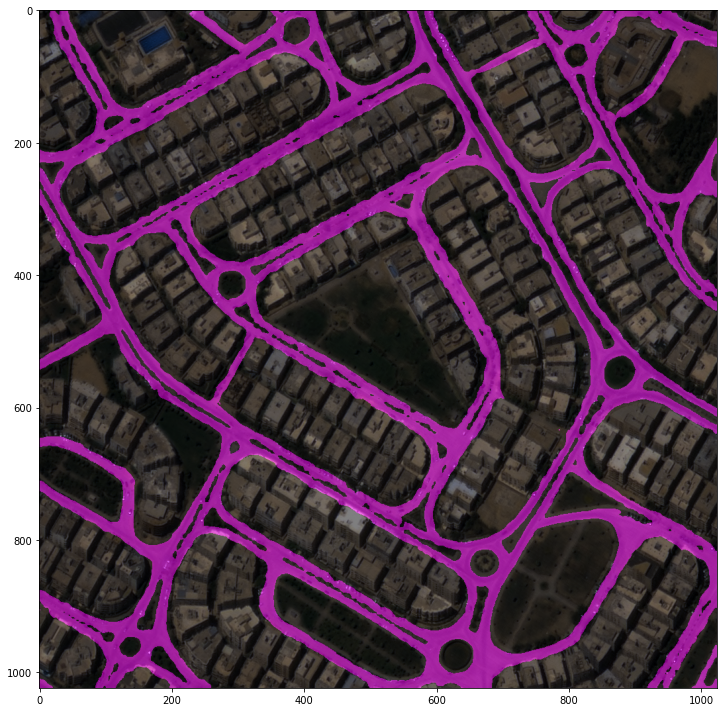

In [ ]:
model.cfg = cfg

img = mmcv.imread('/content/drive/Shareddrives/msmg/level1/dataset/validation/road/image/BLD00173_PS3_K3A_NIA0276.png')
result = inference_segmentor(model, img)
plt.figure(figsize=(10, 10))
show_result_pyplot(model, img, result, palette)

In [ ]:
img = mmcv.imread('/content/drive/Shareddrives/msmg/level1/dataset/validation/road/image/BLD00358_PS3_K3A_NIA0276.png')
result = inference_segmentor(model, img)
plt.figure(figsize=(10, 10))
show_result_pyplot(model, img, result, palette)

In [ ]:
img = mmcv.imread('/content/drive/Shareddrives/msmg/level1/dataset/validation/road/image/BLD01289_PS3_K3A_NIA0373.png')
result = inference_segmentor(model, img)
plt.figure(figsize=(10, 10))
show_result_pyplot(model, img, result, palette)

/content/mmsegmentation/mmseg/models/backbones/resnet.py:431: UserWarning: DeprecationWarning: pretrained is a deprecated, please use "init_cfg" instead
  warnings.warn('DeprecationWarning: pretrained is a deprecated, '
/content/mmsegmentation/mmseg/models/losses/cross_entropy_loss.py:236: UserWarning: Default ``avg_non_ignore`` is False, if you would like to ignore the certain label and average loss over non-ignore labels, which is the same with PyTorch official cross_entropy, set ``avg_non_ignore=True``.
  'Default ``avg_non_ignore`` is False, if you would like to '


load checkpoint from local path: /content/drive/MyDrive/SharedData/sia-satellite-data/Level1-Road-Semantic-Segmenatation/road_ratio100_SemanticFPN_fpn_r101_512x1024_80k_cityscapes_resize1024_baseline_checkpoints/iter_30000.pth


/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


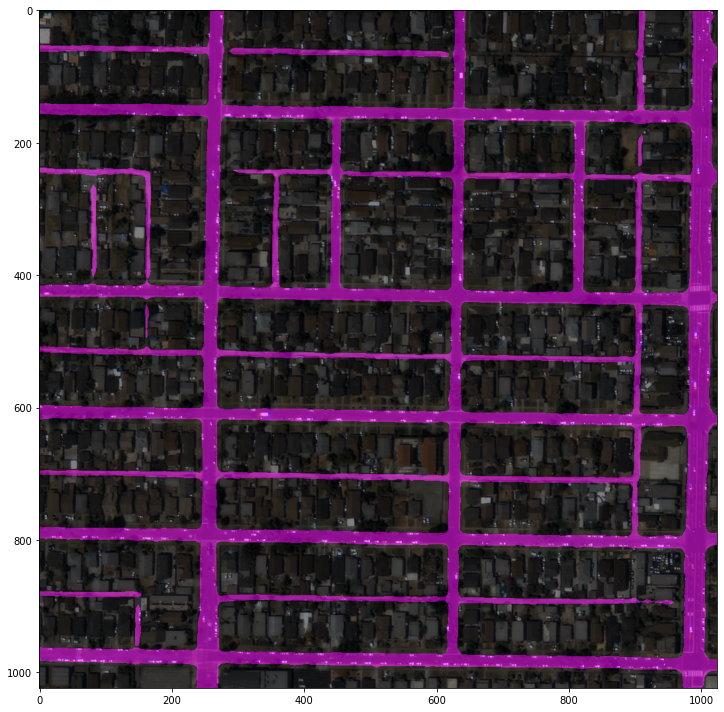

In [ ]:
checkpoint_file = '/content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/best_mIoU_iter_XXXX.pth'  # 학습된 가중치 파일

# checkpoint 저장된 model 파일을 이용하여 모델을 생성, 이때 Config는 위에서 update된 config 사용. 
model_ckpt = init_segmentor(cfg, checkpoint_file, device='cuda:0')  #cuda gpu 사용

img = mmcv.imread('/content/drive/Shareddrives/msmg/level1/dataset/validation/road/image/BLD11474_PS3_K3A_NIA0390.png') # inference할 이미지
result = inference_segmentor(model_ckpt, img)
show_result_pyplot(model_ckpt, img, result, palette)

# Inference and evaluation on the test dataset

In [ ]:
import torch, torchvision

import mmseg
from mmseg.apis import inference_segmentor, init_segmentor, show_result_pyplot
from mmseg.core.evaluation import get_palette
from mmseg.datasets.builder import DATASETS
from mmseg.datasets.custom import CustomDataset
from mmseg.apis import set_random_seed

import mmcv
from mmcv import Config

import matplotlib.pyplot as plt
import os.path as osp
import numpy as np
from PIL import Image

In [ ]:
# convert dataset annotation to semantic segmentation map
data_root = '/content/drive/Shareddrives/msmg/level1/dataset/train/road'
img_dir = 'image'
ann_dir = 'annotation'

# define class and plaette for better visualization
classes = ('background', 'road')
palette = [[0, 0, 0], [255, 0, 255]]

In [ ]:
config_file = '/content/mmsegmentation/configs/segformer/segformer_mit-b5_8x1_1024x1024_160k_cityscapes.py'
checkpoint_file = '/content/mmsegmentation/checkpoints/segformer_mit-b5_8x1_1024x1024_160k_cityscapes_20211206_072934-87a052ec.pth'
save_pth_path = '/content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint'

In [ ]:
@DATASETS.register_module(force=True)
class RoadSemanticSegmentation(CustomDataset):
    CLASSES = classes
    PALETTE = palette
    def __init__(self, split, **kwargs):
        super().__init__(img_suffix='.png', seg_map_suffix='.png', split=split, **kwargs)
        assert osp.exists(self.img_dir) and self.split is not None

In [ ]:
cfg = Config.fromfile(config_file)

In [ ]:
from mmseg.apis import set_random_seed

# add CLASSES and PALETTE to checkpoint
cfg.checkpoint_config.meta = dict(
    CLASSES=classes,
    PALETTE=palette)

# Since we use only one GPU, BN is used instead of SyncBN
cfg.norm_cfg = dict(type='BN', requires_grad=True)
#cfg.model.backbone.norm_cfg = cfg.norm_cfg
cfg.model.decode_head.norm_cfg = cfg.norm_cfg

# modify num classes of the model in decode/auxiliary head
cfg.model.decode_head.num_classes = 2

# modify loss function crossentropy
#cfg.model.decode_head.loss_decode = dict(type='CrossEntropyLoss', class_weight=[1, 2], use_sigmoid=False, loss_weight=1.0)

#cfg.model.test_cfg.mode = 'whole'
#del cfg['model']['test_cfg']['crop_size']
#del cfg['model']['test_cfg']['stride']

# Modify dataset type and path
cfg.dataset_type = 'RoadSemanticSegmentation'
cfg.data_root = data_root

cfg.data.samples_per_gpu = 6
cfg.data.workers_per_gpu = 6

# Albumentations transforms settings
albu_train_transforms = [
    dict(
    type='OneOf',
    transforms=[
        dict(type='RandomRotate90', p=1.0)
    ], p=0.5),

    dict(
    type='OneOf',
    transforms=[
        dict(type='RandomBrightnessContrast',brightness_limit=0.1, contrast_limit=0.15, p=1.0),
        dict(type='CLAHE', clip_limit=4.0, tile_grid_size=(8, 8), always_apply=False, p=1.0),
        dict(type='HueSaturationValue', hue_shift_limit=15, sat_shift_limit=25, val_shift_limit=10, p=1.0),
    ], p=0.5)
]

# pipline
cfg.img_norm_cfg = dict(
    mean=[123.675, 116.28, 103.53], std=[58.395, 57.12, 57.375], to_rgb=True)
cfg.crop_size = (512, 512)
cfg.train_pipeline = [
    dict(type='LoadImageFromFile'),
    dict(type='LoadAnnotations'),
    dict(type='Resize', img_scale=(1024, 1024), ratio_range=(0.5, 1.5)),
    dict(type='RandomCrop', crop_size=cfg.crop_size, cat_max_ratio=0.75),
    dict(type='RandomFlip', flip_ratio=0.5),
    dict(
        type='Albu',
        transforms=albu_train_transforms,
        keymap=dict(img='image', gt_semantic_seg='mask'),
        update_pad_shape=True,
        ),
    dict(type='PhotoMetricDistortion'),
    dict(type='Normalize', **cfg.img_norm_cfg),
    dict(type='Pad', size=cfg.crop_size, pad_val=0, seg_pad_val=255),
    dict(type='DefaultFormatBundle'),
    dict(type='Collect', keys=['img', 'gt_semantic_seg']),
]

cfg.test_pipeline = [
    dict(type='LoadImageFromFile'),
    dict(
        type='MultiScaleFlipAug',
        img_scale=(1024, 1024),
        # img_ratios=[0.5, 0.75, 1.0, 1.25, 1.5, 1.75],
        flip=False,
        transforms=[
            dict(type='Resize', keep_ratio=True),
            dict(type='RandomFlip'),
            dict(type='Normalize', **cfg.img_norm_cfg),
            dict(type='ImageToTensor', keys=['img']),
            dict(type='Collect', keys=['img']),
        ])
]

cfg.data.train.type = cfg.dataset_type
cfg.data.train.data_root = '/content/drive/Shareddrives/msmg/level1/dataset/train/road/'
cfg.data.train.img_dir = 'image'
cfg.data.train.ann_dir = 'annotation'
cfg.data.train.pipeline = cfg.train_pipeline
cfg.data.train.split = 'split/train.txt'

cfg.data.val.type = cfg.dataset_type
cfg.data.val.data_root = '/content/drive/Shareddrives/msmg/level1/dataset/validation/road/'
cfg.data.val.img_dir = 'image'
cfg.data.val.ann_dir = 'annotation'
cfg.data.val.pipeline = cfg.test_pipeline
cfg.data.val.split = 'split/validation.txt'

cfg.data.test.type = cfg.dataset_type
cfg.data.test.data_root = '/content/drive/Shareddrives/msmg/level1/dataset/validation/road/'
cfg.data.test.img_dir = 'image'
cfg.data.test.ann_dir = 'annotation'
cfg.data.test.pipeline = cfg.test_pipeline
cfg.data.test.split = 'split/validation.txt'

# We can still use the pre-trained Mask RCNN model though we do not need to
# use the mask branch
cfg.load_from = checkpoint_file

# Set up working dir to save files and logs.
cfg.work_dir = save_pth_path

cfg.runner.max_iters = 10000
cfg.log_config.interval = 10
cfg.evaluation.interval = 100
cfg.evaluation.save_best = 'mIoU'
cfg.checkpoint_config.interval = 2000

# Set seed to facitate reproducing the result
cfg.seed = 0
set_random_seed(0, deterministic=False)
cfg.gpu_ids = range(1)

# We can also use tensorboard to log the training process
cfg.log_config.hooks = [
    dict(type='TextLoggerHook'),
    dict(type='TensorboardLoggerHook')]

# Let's have a look at the final config used for training
print(f'Config:\n{cfg.pretty_text}')

Config:
norm_cfg = dict(type='BN', requires_grad=True)
model = dict(
    type='EncoderDecoder',
    pretrained=None,
    backbone=dict(
        type='MixVisionTransformer',
        in_channels=3,
        embed_dims=64,
        num_stages=4,
        num_layers=[3, 6, 40, 3],
        num_heads=[1, 2, 5, 8],
        patch_sizes=[7, 3, 3, 3],
        sr_ratios=[8, 4, 2, 1],
        out_indices=(0, 1, 2, 3),
        mlp_ratio=4,
        qkv_bias=True,
        drop_rate=0.0,
        attn_drop_rate=0.0,
        drop_path_rate=0.1,
        init_cfg=dict(type='Pretrained', checkpoint='pretrain/mit_b5.pth')),
    decode_head=dict(
        type='SegformerHead',
        in_channels=[64, 128, 320, 512],
        in_index=[0, 1, 2, 3],
        channels=256,
        dropout_ratio=0.1,
        num_classes=2,
        norm_cfg=dict(type='BN', requires_grad=True),
        align_corners=False,
        loss_decode=dict(
            type='CrossEntropyLoss', use_sigmoid=False, loss_weight=1.0)),
    train_cfg

/content/mmsegmentation/mmseg/models/losses/cross_entropy_loss.py:236: UserWarning: Default ``avg_non_ignore`` is False, if you would like to ignore the certain label and average loss over non-ignore labels, which is the same with PyTorch official cross_entropy, set ``avg_non_ignore=True``.
  'Default ``avg_non_ignore`` is False, if you would like to '


load checkpoint from local path: /content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/iter_10000.pth


/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


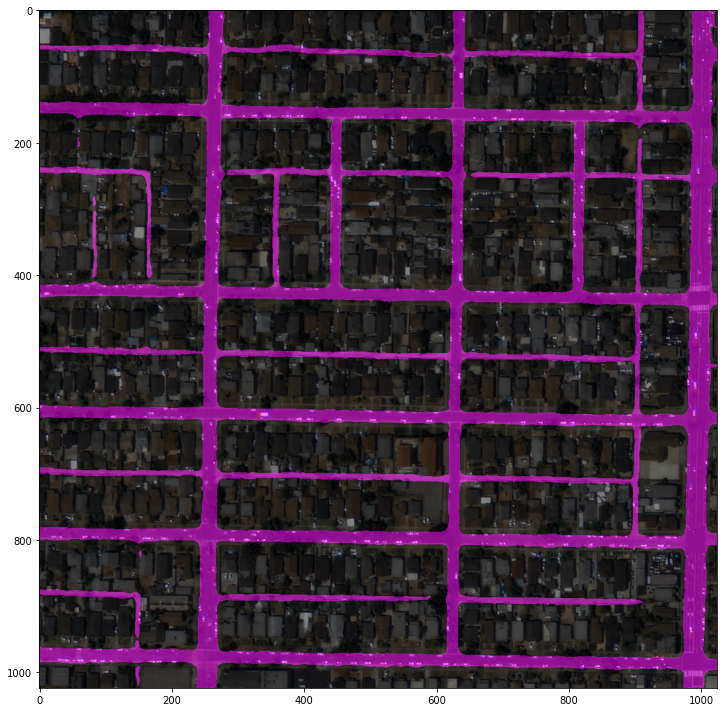

In [ ]:
checkpoint_file = '/content/drive/Shareddrives/msmg/level1/source/road/segformer/mit-b5/no2_iter15000_checkpoint/iter_10000.pth'  # 학습된 가중치 파일

# checkpoint 저장된 model 파일을 이용하여 모델을 생성, 이때 Config는 위에서 update된 config 사용. 
model_ckpt = init_segmentor(cfg, checkpoint_file, device='cuda:0')  #cuda gpu 사용

img = mmcv.imread('/content/drive/Shareddrives/msmg/level1/dataset/validation/road/image/BLD11474_PS3_K3A_NIA0390.png') # inference할 이미지
result = inference_segmentor(model_ckpt, img)
show_result_pyplot(model_ckpt, img, result, palette)

/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


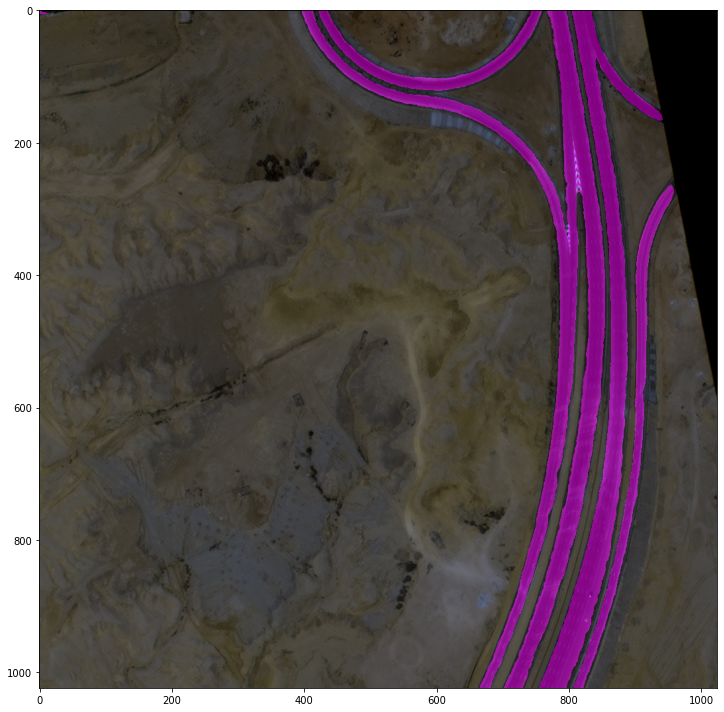

In [ ]:
img = mmcv.imread('/content/drive/Shareddrives/msmg/level1/dataset/validation/road/image/BLD00358_PS3_K3A_NIA0276.png') # inference할 이미지
result = inference_segmentor(model_ckpt, img)
show_result_pyplot(model_ckpt, img, result, palette)

/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


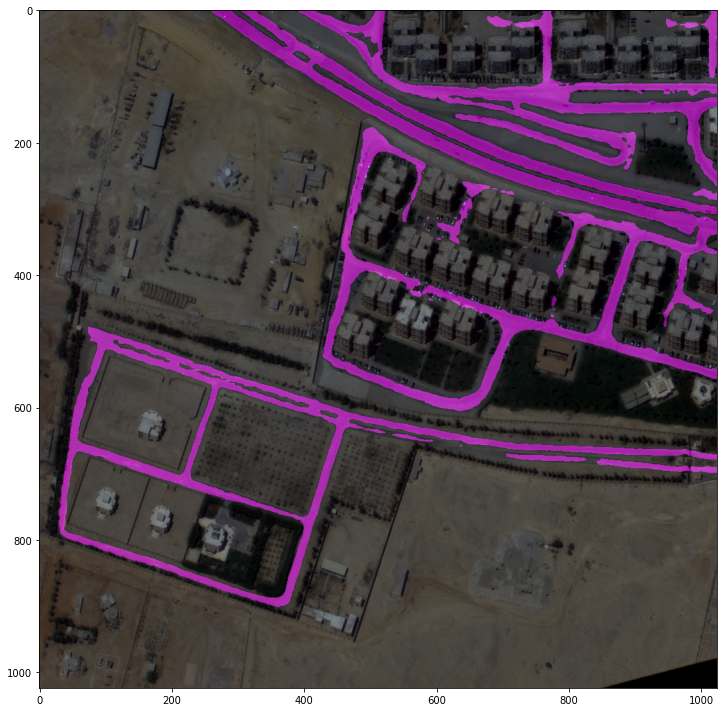

In [ ]:
img = mmcv.imread('/content/drive/Shareddrives/msmg/level1/dataset/validation/road/image/BLD01117_PS3_K3A_NIA0277.png')
result = inference_segmentor(model_ckpt, img)
show_result_pyplot(model_ckpt, img, result, palette)

/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


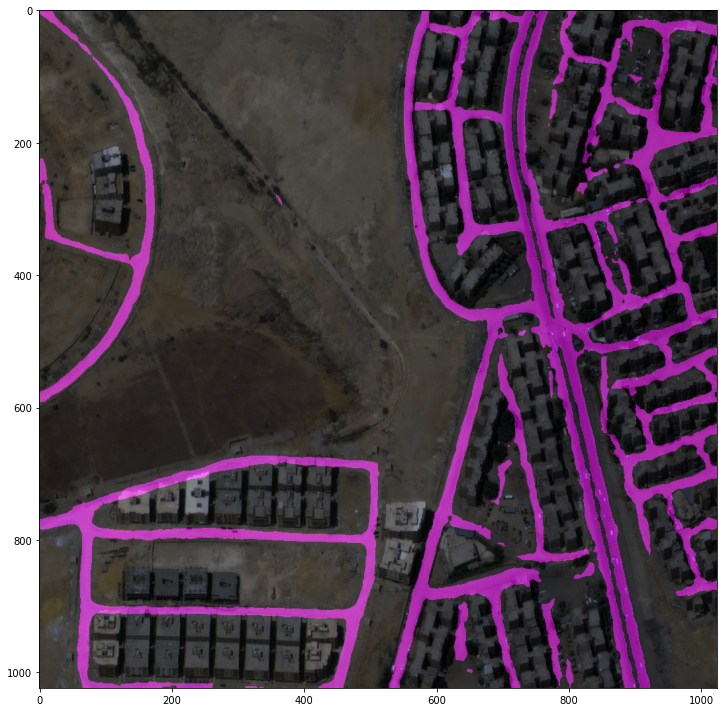

In [ ]:
img = mmcv.imread('/content/drive/Shareddrives/msmg/level1/dataset/validation/road/image/BLD00108_PS3_K3A_NIA0276.png')
result = inference_segmentor(model_ckpt, img)
show_result_pyplot(model_ckpt, img, result, palette)

/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


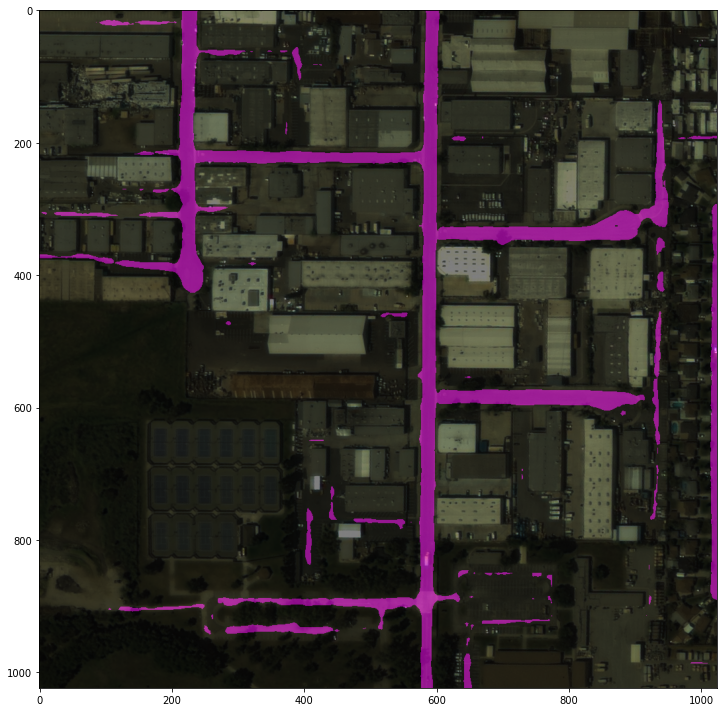

In [ ]:
img = mmcv.imread('/content/drive/Shareddrives/msmg/level1/dataset/validation/road/image/BLD07416_PS3_K3A_NIA0383.png')
result = inference_segmentor(model_ckpt, img)
show_result_pyplot(model_ckpt, img, result, palette)

/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


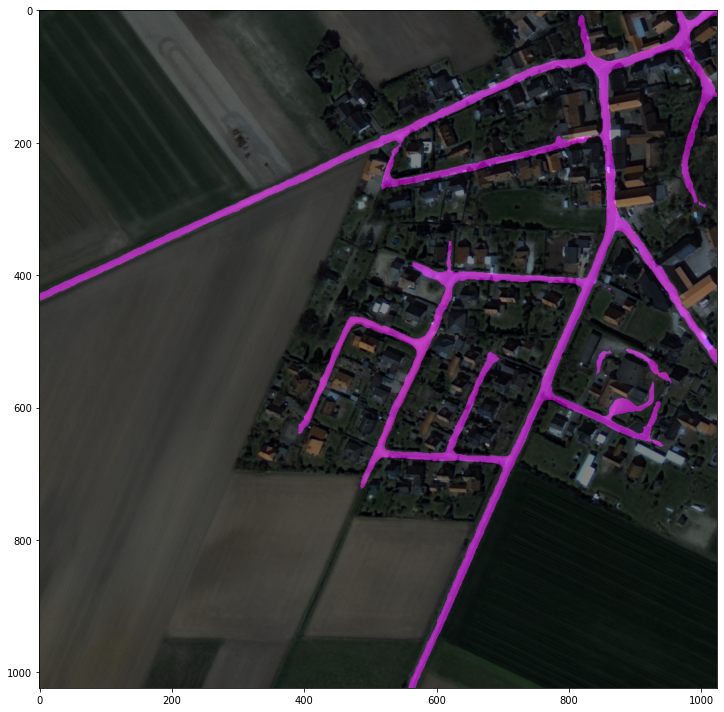

In [ ]:
img = mmcv.imread('/content/drive/Shareddrives/msmg/level1/dataset/validation/road/image/BLD03008_PS3_K3A_NIA0375.png')
result = inference_segmentor(model_ckpt, img)
show_result_pyplot(model_ckpt, img, result, palette)

/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


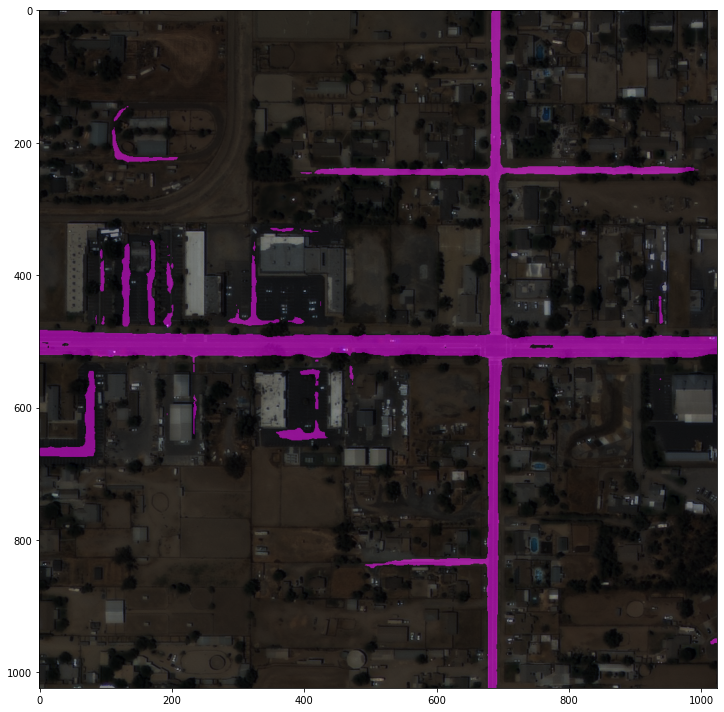

In [ ]:
img = mmcv.imread('/content/drive/Shareddrives/msmg/level1/dataset/validation/road/image/BLD09984_PS3_K3A_NIA0387.png')
result = inference_segmentor(model_ckpt, img)
show_result_pyplot(model_ckpt, img, result, palette)

/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


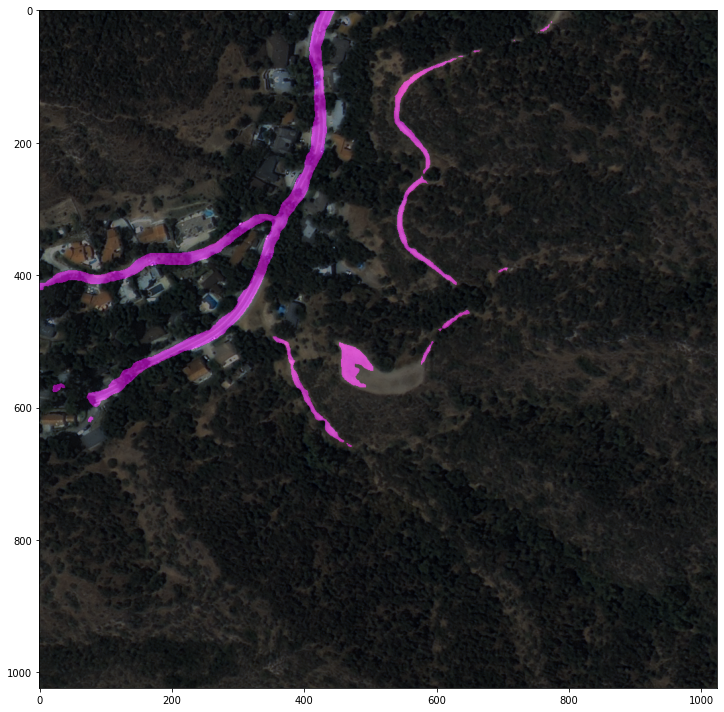

In [ ]:
img = mmcv.imread('/content/drive/Shareddrives/msmg/level1/dataset/validation/road/image/BLD11785_PS3_K3A_NIA0391.png')
result = inference_segmentor(model_ckpt, img)
show_result_pyplot(model_ckpt, img, result, palette)

/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


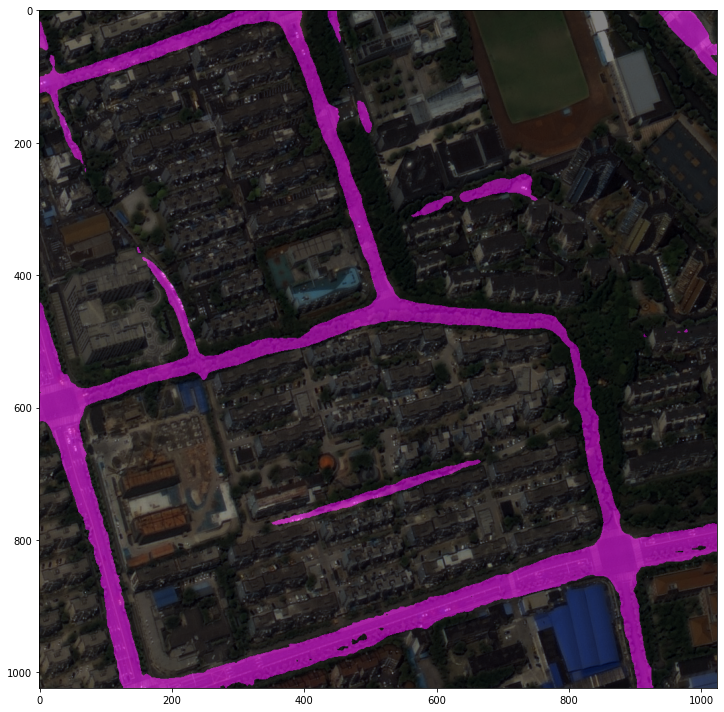

In [ ]:
img = mmcv.imread('/content/drive/Shareddrives/msmg/level1/dataset/validation/road/image/BLD01864_PS3_K3A_NIA0374.png')
result = inference_segmentor(model_ckpt, img)
show_result_pyplot(model_ckpt, img, result, palette)

/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


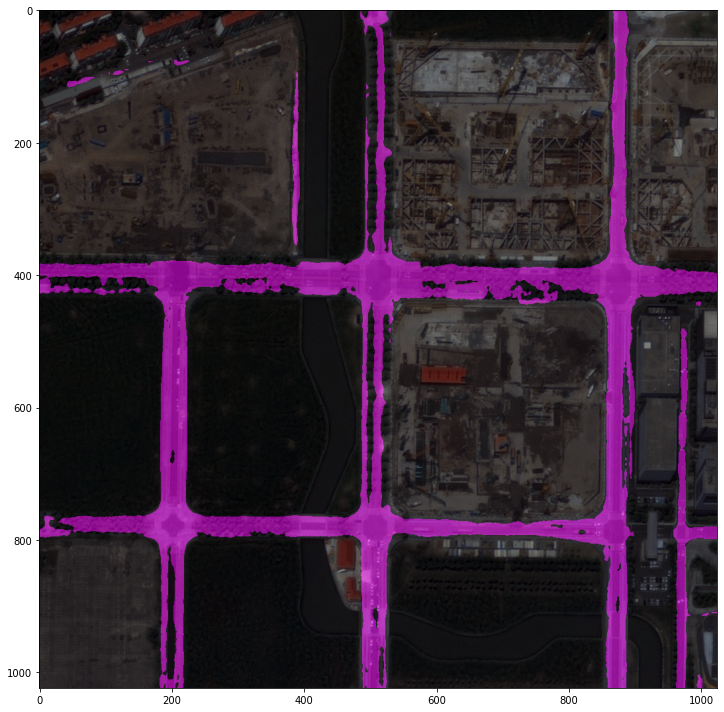

In [ ]:
img = mmcv.imread('/content/drive/Shareddrives/msmg/level1/dataset/validation/road/image/BLD01289_PS3_K3A_NIA0373.png')
result = inference_segmentor(model_ckpt, img)
show_result_pyplot(model_ckpt, img, result, palette)

In [ ]:
from mmseg.datasets import (build_dataloader, build_dataset)

# test용 Dataset과 DataLoader 생성. 
# build_dataset()호출 시 list로 감싸지 않는 것이 train용 dataset 생성시와 차이. 
dataset = build_dataset(cfg.data.test)
data_loader = build_dataloader(
        dataset,
        # 반드시 아래 samples_per_gpu 인자값은 1로 설정
        #samples_per_gpu=cfg.data.samples_per_gpu,
        #workers_per_gpu=cfg.data.workers_per_gpu,
        samples_per_gpu=1,
        workers_per_gpu=1,
        dist=False,
        shuffle=False)

2022-06-07 07:25:35,508 - mmseg - INFO - Loaded 127 images


In [ ]:
from mmseg.apis import multi_gpu_test, single_gpu_test
from mmcv.parallel import MMDataParallel, MMDistributedDataParallel
#from mmseg.apis import inference_detector, init_detector, show_result_pyplot

model_ckpt = MMDataParallel(model_ckpt, device_ids=[0])

In [ ]:
# single_gpu_test() 를 호출하여 test데이터 세트의 interence 수행. 반드시 batch size는 1이 되어야 함. 
# 위에서 만든 /content/show_test_output 디렉토리에 interence 결과가 시각화된 이미지가 저장됨. 
outputs = single_gpu_test(model_ckpt, data_loader, False, '/content/test', 1.0)

[                                                  ] 0/127, elapsed: 0s, ETA:

/content/mmsegmentation/mmseg/apis/test.py:69: UserWarning: DeprecationWarning: ``efficient_test`` will be deprecated, the evaluation is CPU memory friendly with pre_eval=True
  'DeprecationWarning: ``efficient_test`` will be deprecated, the '


[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 127/127, 1.8 task/s, elapsed: 72s, ETA:     0s

In [ ]:
metric = dataset.evaluate(outputs, metric='mIoU')
print(metric)

per class results:

+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 94.67 | 97.26 |
|    road    | 63.17 | 77.46 |
+------------+-------+-------+
Summary:

+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 95.12 | 78.92 | 87.36 |
+-------+-------+-------+
{'aAcc': 0.9512, 'mIoU': 0.7892, 'mAcc': 0.8736, 'IoU.background': 0.9467, 'IoU.road': 0.6317, 'Acc.background': 0.9726, 'Acc.road': 0.7746}
